# data Preparation

In [ ]:
!wget https://figshare.com/ndownloader/files/36977293 -O ThingsEEG-Text.zip

In [ ]:
!mkdir data/

In [ ]:
!mv ThingsEEG-Text.zip data/

In [ ]:
cd data/

In [ ]:
!unzip ThingsEEG-Text.zip

In [ ]:
cd ..

Data Summary 

In [50]:
import torch
import os
import scipy.io as sio
from sklearn.model_selection import train_test_split
import numpy as np

# load data
data_dir_root = os.path.join('./data', 'ThingsEEG-Text')
sbj = 'sub-10'
image_model = 'pytorch/cornet_s'
text_model = 'CLIPText'
roi = '17channels'
brain_dir = os.path.join(data_dir_root, 'brain_feature', roi, sbj)
image_dir_seen = os.path.join(data_dir_root, 'visual_feature/ThingsTrain', image_model, sbj)
image_dir_unseen = os.path.join(data_dir_root, 'visual_feature/ThingsTest', image_model, sbj)
text_dir_seen = os.path.join(data_dir_root, 'textual_feature/ThingsTrain/text', text_model, sbj)
text_dir_unseen = os.path.join(data_dir_root, 'textual_feature/ThingsTest/text', text_model, sbj)

brain_seen = sio.loadmat(os.path.join(brain_dir, 'eeg_train_data_within.mat'))['data'].astype('double') * 2.0
brain_seen = brain_seen[:,:,27:60] # 70ms-400ms
brain_seen = np.reshape(brain_seen, (brain_seen.shape[0], -1))
image_seen = sio.loadmat(os.path.join(image_dir_seen, 'feat_pca_train.mat'))['data'].astype('double')*50.0
text_seen = sio.loadmat(os.path.join(text_dir_seen, 'text_feat_train.mat'))['data'].astype('double')*2.0
label_seen = sio.loadmat(os.path.join(brain_dir, 'eeg_train_data_within.mat'))['class_idx'].T.astype('int')
image_seen = image_seen[:,0:100]

brain_unseen = sio.loadmat(os.path.join(brain_dir, 'eeg_test_data.mat'))['data'].astype('double')*2.0
brain_unseen = brain_unseen[:, :, 27:60]
brain_unseen = np.reshape(brain_unseen, (brain_unseen.shape[0], -1))
image_unseen = sio.loadmat(os.path.join(image_dir_unseen, 'feat_pca_test.mat'))['data'].astype('double')*50.0
text_unseen = sio.loadmat(os.path.join(text_dir_unseen, 'text_feat_test.mat'))['data'].astype('double')*2.0
label_unseen = sio.loadmat(os.path.join(brain_dir, 'eeg_test_data.mat'))['class_idx'].T.astype('int')
image_unseen = image_unseen[:, 0:100]

brain_seen = torch.from_numpy(brain_seen)
brain_unseen = torch.from_numpy(brain_unseen)
image_seen = torch.from_numpy(image_seen)
image_unseen = torch.from_numpy(image_unseen)
text_seen = torch.from_numpy(text_seen)
text_unseen = torch.from_numpy(text_unseen)
label_seen = torch.from_numpy(label_seen)
label_unseen = torch.from_numpy(label_unseen)

print('seen_brain_samples=', brain_seen.shape[0], ', seen_brain_features=', brain_seen.shape[1])
print('seen_image_samples=', image_seen.shape[0], ', seen_image_features=', image_seen.shape[1])
print('seen_text_samples=', text_seen.shape[0], ', seen_text_features=', text_seen.shape[1])
print('seen_label=', label_seen.shape)
print('unseen_brain_samples=', brain_unseen.shape[0], ', unseen_brain_features=', brain_unseen.shape[1])
print('unseen_image_samples=', image_unseen.shape[0], ', unseen_image_features=', image_unseen.shape[1])
print('unseen_text_samples=', text_unseen.shape[0], ', unseen_text_features=', text_unseen.shape[1])
print('unseen_label=', label_unseen.shape)

seen_brain_samples= 16540 , seen_brain_features= 561
seen_image_samples= 16540 , seen_image_features= 100
seen_text_samples= 16540 , seen_text_features= 512
seen_label= torch.Size([16540, 1])
unseen_brain_samples= 16000 , unseen_brain_features= 561
unseen_image_samples= 16000 , unseen_image_features= 100
unseen_text_samples= 16000 , unseen_text_features= 512
unseen_label= torch.Size([16000, 1])


# exploration of the data pt.2 


In [51]:
import torch
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [52]:
#Convert PyTorch Tensors to NumPy Arrays
brain_seen_np = brain_seen.numpy()
image_seen_np = image_seen.numpy()
text_seen_np  = text_seen.numpy()
label_seen_np = label_seen.numpy().flatten()  # flatten to shape (N,) for easier use in pandas

In [53]:
#Create Column Names for Each Feature Set
num_brain_features = brain_seen_np.shape[1]  # 561
num_image_features = image_seen_np.shape[1]  # 100
num_text_features  = text_seen_np.shape[1]   # 512

brain_columns = [f"brain_{i}" for i in range(num_brain_features)]
image_columns = [f"image_{i}" for i in range(num_image_features)]
text_columns  = [f"text_{i}"  for i in range(num_text_features)]

In [58]:
df_brain_seen = pd.DataFrame(brain_seen_np, columns=brain_columns)
df_brain_seen["label"] = label_seen_np

print(df_brain_seen.head())
print(df_brain_seen.shape)

    brain_0   brain_1   brain_2   brain_3   brain_4   brain_5   brain_6  \
0  0.181086  0.383238  0.148572  0.362642  0.380157 -0.132330 -0.835796   
1 -0.269994 -0.161154 -0.173305  0.246614  0.114574  0.064350 -0.636511   
2 -1.101100 -0.196966  0.507806  0.552215  0.416258 -1.073705 -1.887706   
3  0.329524  0.292627 -0.183675  0.167948 -0.144916  0.333150  0.744820   
4  1.238872  1.528632  1.182186  1.217510  0.921484  0.748299  0.282835   

    brain_7   brain_8   brain_9  ...  brain_552  brain_553  brain_554  \
0 -0.211023 -0.674189 -0.893508  ...   0.610989   0.616923   0.591801   
1 -0.740275 -0.681264 -0.396427  ...   0.080109   0.027442  -0.055867   
2 -1.590339 -1.346330 -1.468380  ...  -0.281819  -0.998308  -0.836045   
3  1.047985  0.677371  0.637663  ...  -0.319176  -0.300166  -0.702255   
4  0.043261 -0.175415  0.023306  ...   0.198496   0.397676  -0.039232   

   brain_555  brain_556  brain_557  brain_558  brain_559  brain_560  label  
0   0.490052   0.644682   0.79285

In [59]:
df_image_seen = pd.DataFrame(image_seen_np, columns=image_columns)
df_image_seen["label"] = label_seen_np

print(df_image_seen.head())
print(df_image_seen.shape)

     image_0   image_1    image_2    image_3   image_4    image_5    image_6  \
0   6.982257 -1.796602  -6.491420 -13.285898  3.519372 -10.838217   7.423459   
1  24.356928 -1.073643  -3.370211 -18.174984  0.086564  -6.784516  11.361523   
2  10.876573  6.262606  -7.877734 -17.742774  3.479697  -0.773807   3.677609   
3  22.526658 -7.998147 -19.451824 -14.987399  8.569052   0.677897   0.524766   
4  24.572992  3.162243 -14.405145 -12.893601  3.880119  -5.359508   6.158181   

    image_7   image_8   image_9  ...  image_91  image_92  image_93  image_94  \
0  3.710766 -2.838341 -9.112432  ... -2.136884  0.857794  2.322350  1.664187   
1 -2.447867 -1.403254 -4.435863  ... -2.885591 -0.040527  0.917110 -0.595191   
2 -2.095303  4.641868 -7.709894  ... -6.096052 -0.526765  2.523454  1.895739   
3 -3.040728 -0.462643 -1.509947  ... -4.279700  3.267778 -0.275315  3.010003   
4  8.136662 -8.100194 -2.490007  ...  0.735770 -0.288139 -1.500778  0.623438   

   image_95  image_96  image_97  image

In [60]:
df_text_seen = pd.DataFrame(text_seen_np, columns=text_columns)
df_text_seen["label"] = label_seen_np

print(df_text_seen.head())
print(df_text_seen.shape)

     text_0    text_1    text_2    text_3    text_4    text_5    text_6  \
0 -1.051765 -0.188069 -0.595092 -0.106280 -0.000042  0.259468 -0.824246   
1 -0.791820  0.722638 -0.750893  0.604263 -0.096118 -0.180995 -0.107345   
2 -0.655546 -0.335914 -1.071692  0.533285 -0.043359  0.137325  0.269942   
3  0.053093 -0.368174  0.087328  0.263806  0.739228 -0.116403 -0.232868   
4 -0.698951  0.777568 -0.961129  0.507661 -0.686843 -0.570301 -0.339451   

     text_7    text_8    text_9  ...  text_503  text_504  text_505  text_506  \
0 -1.074296  0.100001  0.452961  ...  0.850631 -0.411319  0.273861 -0.207523   
1 -1.378767  0.089730  0.755525  ...  0.493041 -0.111407 -0.047574 -0.712646   
2 -1.501647 -1.331311 -0.012337  ... -0.042760  0.050774  0.037872 -0.212290   
3 -0.883717 -0.983919  0.725002  ... -0.100994  0.504711  0.125284 -0.154703   
4 -1.376515  0.448556  0.833378  ... -0.312372 -0.206590 -0.470965 -0.890891   

   text_507  text_508  text_509  text_510  text_511  label  
0  0.58

In [61]:
print("Brain Data: Class Distribution (seen)")
print(df_brain_seen["label"].value_counts())

print("\nImage Data: Class Distribution (seen)")
print(df_image_seen["label"].value_counts())

print("\nText Data: Class Distribution (seen)")
print(df_text_seen["label"].value_counts())

Brain Data: Class Distribution (seen)
label
1       10
1100    10
1110    10
1109    10
1108    10
        ..
549     10
548     10
547     10
546     10
1654    10
Name: count, Length: 1654, dtype: int64

Image Data: Class Distribution (seen)
label
1       10
1100    10
1110    10
1109    10
1108    10
        ..
549     10
548     10
547     10
546     10
1654    10
Name: count, Length: 1654, dtype: int64

Text Data: Class Distribution (seen)
label
1       10
1100    10
1110    10
1109    10
1108    10
        ..
549     10
548     10
547     10
546     10
1654    10
Name: count, Length: 1654, dtype: int64


In [62]:
# Brain features
brain_stats = df_brain_seen[brain_columns].describe()
print("Brain Features Summary:\n", brain_stats)

# Image features
image_stats = df_image_seen[image_columns].describe()
print("\nImage Features Summary:\n", image_stats)

# Text features
text_stats = df_text_seen[text_columns].describe()
print("\nText Features Summary:\n", text_stats)

Brain Features Summary:
             brain_0       brain_1       brain_2       brain_3       brain_4  \
count  16540.000000  16540.000000  16540.000000  16540.000000  16540.000000   
mean       0.076787      0.070698      0.028373     -0.044438     -0.067034   
std        0.583893      0.592233      0.610593      0.630831      0.641200   
min       -2.762807     -2.598095     -2.349412     -2.818633     -3.008686   
25%       -0.309925     -0.320417     -0.378459     -0.459167     -0.493376   
50%        0.072401      0.068746      0.033988     -0.046756     -0.061193   
75%        0.464845      0.459148      0.433262      0.374403      0.357285   
max        2.293334      2.570706      2.949977      2.507507      2.499492   

            brain_5       brain_6       brain_7       brain_8       brain_9  \
count  16540.000000  16540.000000  16540.000000  16540.000000  16540.000000   
mean      -0.127158     -0.140791     -0.122330     -0.069163     -0.012199   
std        0.646158      0

In [63]:
class_counts = df_brain_seen["label"].value_counts()
print("Class Distribution:\n", class_counts)
# Quick ratio check
print("Ratio of classes:\n", class_counts / len(df_brain_seen))

Class Distribution:
 label
1       10
1100    10
1110    10
1109    10
1108    10
        ..
549     10
548     10
547     10
546     10
1654    10
Name: count, Length: 1654, dtype: int64
Ratio of classes:
 label
1       0.000605
1100    0.000605
1110    0.000605
1109    0.000605
1108    0.000605
          ...   
549     0.000605
548     0.000605
547     0.000605
546     0.000605
1654    0.000605
Name: count, Length: 1654, dtype: float64


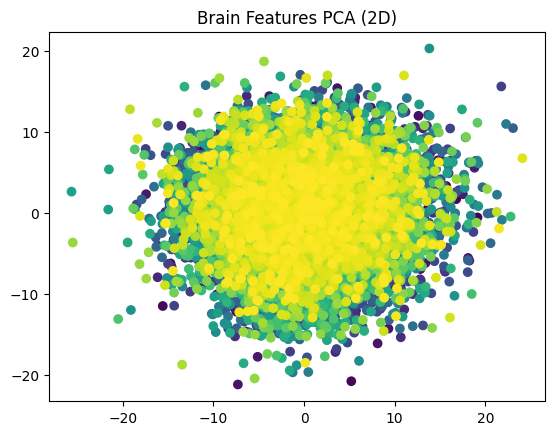

In [66]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)
brain_pca = pca.fit_transform(df_brain_seen[brain_columns])
plt.scatter(brain_pca[:,0], brain_pca[:,1], c=df_brain_seen["label"])
plt.title("Brain Features PCA (2D)")
plt.show()

In [68]:
num_duplicates = df_brain_seen.duplicated().sum()
print(f"Number of duplicate rows in Brain Data: {num_duplicates}")

Number of duplicate rows in Brain Data: 0


In [71]:
from sklearn.feature_selection import f_classif

F, p_values = f_classif(df_brain_seen[brain_columns], df_brain_seen["label"])
for i, (f_val, p_val) in enumerate(zip(F, p_values)):
    print(brain_columns[i], "F-value:", f_val, "p-value:", p_val)

brain_0 F-value: 0.9808834808155859 p-value: 0.6968213502577982
brain_1 F-value: 1.0576554339867317 p-value: 0.06056713513158516
brain_2 F-value: 1.1011180007830343 p-value: 0.0037827902498239244
brain_3 F-value: 1.1331890548592536 p-value: 0.000253274206305681
brain_4 F-value: 1.1326778780258424 p-value: 0.00026556102231483036
brain_5 F-value: 1.1526336901694392 p-value: 3.778125513466674e-05
brain_6 F-value: 1.1656018167424569 p-value: 9.539784275884461e-06
brain_7 F-value: 1.130362238461849 p-value: 0.0003285618434619612
brain_8 F-value: 1.1508072284281003 p-value: 4.55501118259636e-05
brain_9 F-value: 1.1569049287973916 p-value: 2.423699143861756e-05
brain_10 F-value: 1.15768361986674 p-value: 2.2330402539329074e-05
brain_11 F-value: 1.1329257862427886 p-value: 0.00025953394727122473
brain_12 F-value: 1.1348169973099886 p-value: 0.00021760833494122107
brain_13 F-value: 1.112688066475806 p-value: 0.0015195616194919465
brain_14 F-value: 1.113479706964267 p-value: 0.001423879922202786

In [72]:
import numpy as np
import pandas as pd

# Example: correlate brain features (561 dims) with image features (100 dims)
brain_data = df_brain_seen[brain_columns].values  # shape (N, 561)
image_data = df_image_seen[image_columns].values  # shape (N, 100)

# We'll compute correlation of each brain feature with each image feature
corr_matrix = np.corrcoef(brain_data.T, image_data.T)

# This correlation matrix is of size (561 + 100) x (561 + 100).
# The top-left 561x561 block is brain-brain correlation,
# the bottom-right 100x100 block is image-image correlation,
# and the off-diagonal blocks are cross-correlations between brain & image.

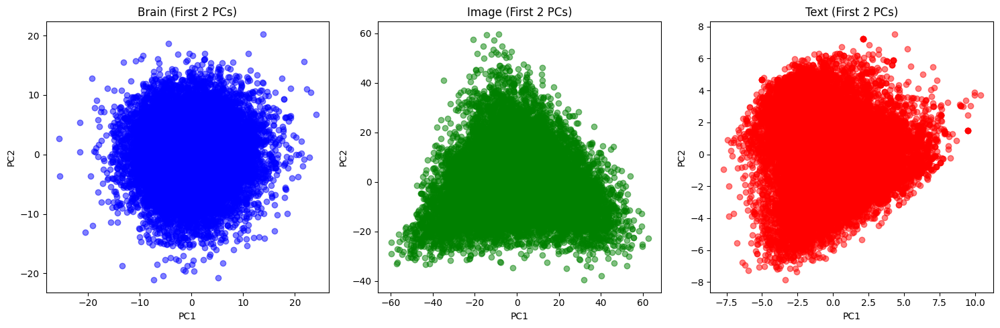

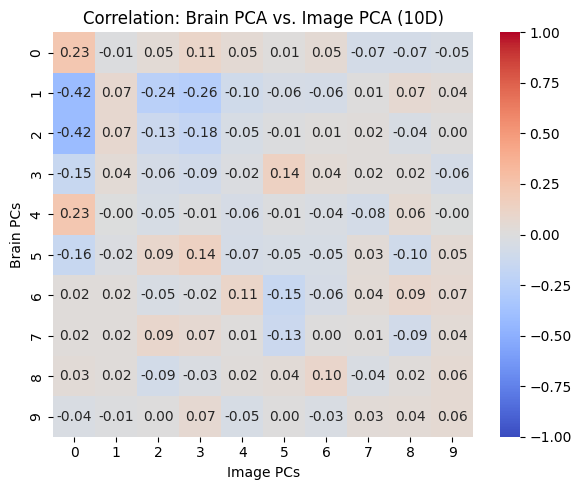

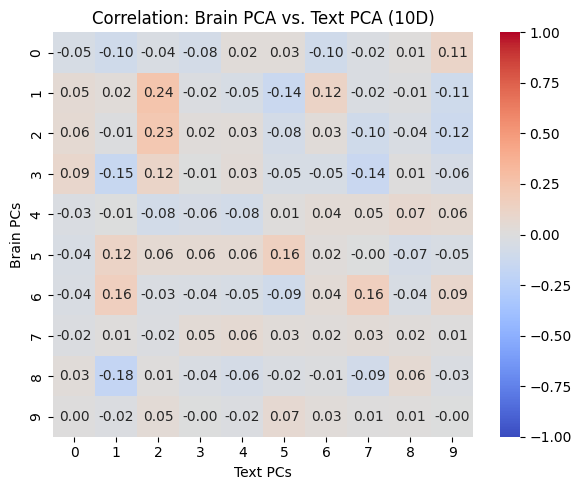

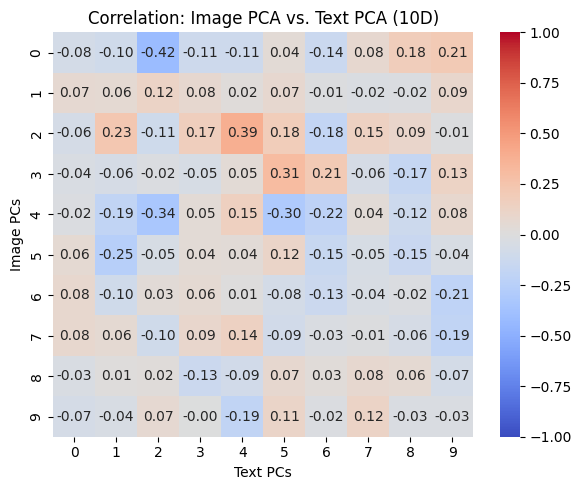

In [73]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA

#----------------------------------------------------------------#
# 1. Specify your columns and load the data
#----------------------------------------------------------------#
brain_columns = [col for col in df_brain_seen.columns if col.startswith('brain_')]
image_columns = [col for col in df_image_seen.columns if col.startswith('image_')]
text_columns  = [col for col in df_text_seen.columns  if col.startswith('text_')]

# Convert the relevant DataFrame slices to NumPy arrays
brain_data = df_brain_seen[brain_columns].values  # shape: (N, 561) for example
image_data = df_image_seen[image_columns].values  # shape: (N, 100)
text_data  = df_text_seen[text_columns].values    # shape: (N, 512)

#----------------------------------------------------------------#
# 2. PCA to reduce dimensionality of each modality (e.g., to 10D)
#----------------------------------------------------------------#
pca_dim = 10  # choose how many principal components you want
pca_brain = PCA(n_components=pca_dim).fit_transform(brain_data)
pca_image = PCA(n_components=pca_dim).fit_transform(image_data)
pca_text  = PCA(n_components=pca_dim).fit_transform(text_data)

# pca_brain, pca_image, pca_text now have shapes (N, 10) each

#----------------------------------------------------------------#
# 3. Scatter plot of first two principal components (PCs)
#    This gives a quick 2D view of each modality.
#----------------------------------------------------------------#
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

axes[0].scatter(pca_brain[:, 0], pca_brain[:, 1], alpha=0.5, color='blue')
axes[0].set_title("Brain (First 2 PCs)")
axes[0].set_xlabel("PC1")
axes[0].set_ylabel("PC2")

axes[1].scatter(pca_image[:, 0], pca_image[:, 1], alpha=0.5, color='green')
axes[1].set_title("Image (First 2 PCs)")
axes[1].set_xlabel("PC1")
axes[1].set_ylabel("PC2")

axes[2].scatter(pca_text[:, 0], pca_text[:, 1], alpha=0.5, color='red')
axes[2].set_title("Text (First 2 PCs)")
axes[2].set_xlabel("PC1")
axes[2].set_ylabel("PC2")

plt.tight_layout()
plt.show()

#----------------------------------------------------------------#
# 4. Correlation heatmaps between modalities in the 10D PCA space
#    We'll compare:
#    A) Brain vs Image
#    B) Brain vs Text
#    C) Image vs Text
#----------------------------------------------------------------#

# Helper function to compute cross-correlation matrix
def cross_corr(X, Y):
    """
    Compute correlation matrix between each column in X and each column in Y.
    X: (N, dX)
    Y: (N, dY)
    Returns: (dX, dY) correlation matrix
    """
    # Concatenate to do a single correlation
    # We do row-wise (features as columns), so we transpose:
    combined = np.corrcoef(X.T, Y.T)  
    dX = X.shape[1]
    dY = Y.shape[1]
    # The cross block is top-left or bottom-right depending on arrangement.
    # In this arrangement, the top-left block is X-X, the bottom-right is Y-Y.
    # We want the off-diagonal block: [0:dX, dX : dX+dY]
    cross = combined[0:dX, dX:dX+dY]
    return cross

# A) Brain vs. Image
corr_bi = cross_corr(pca_brain, pca_image)

plt.figure(figsize=(6, 5))
sns.heatmap(corr_bi, vmin=-1, vmax=1, cmap="coolwarm", annot=True, fmt=".2f")
plt.title("Correlation: Brain PCA vs. Image PCA (10D)")
plt.xlabel("Image PCs")
plt.ylabel("Brain PCs")
plt.tight_layout()
plt.show()

# B) Brain vs. Text
corr_bt = cross_corr(pca_brain, pca_text)

plt.figure(figsize=(6, 5))
sns.heatmap(corr_bt, vmin=-1, vmax=1, cmap="coolwarm", annot=True, fmt=".2f")
plt.title("Correlation: Brain PCA vs. Text PCA (10D)")
plt.xlabel("Text PCs")
plt.ylabel("Brain PCs")
plt.tight_layout()
plt.show()

# C) Image vs. Text
corr_it = cross_corr(pca_image, pca_text)

plt.figure(figsize=(6, 5))
sns.heatmap(corr_it, vmin=-1, vmax=1, cmap="coolwarm", annot=True, fmt=".2f")
plt.title("Correlation: Image PCA vs. Text PCA (10D)")
plt.xlabel("Text PCs")
plt.ylabel("Image PCs")
plt.tight_layout()
plt.show()

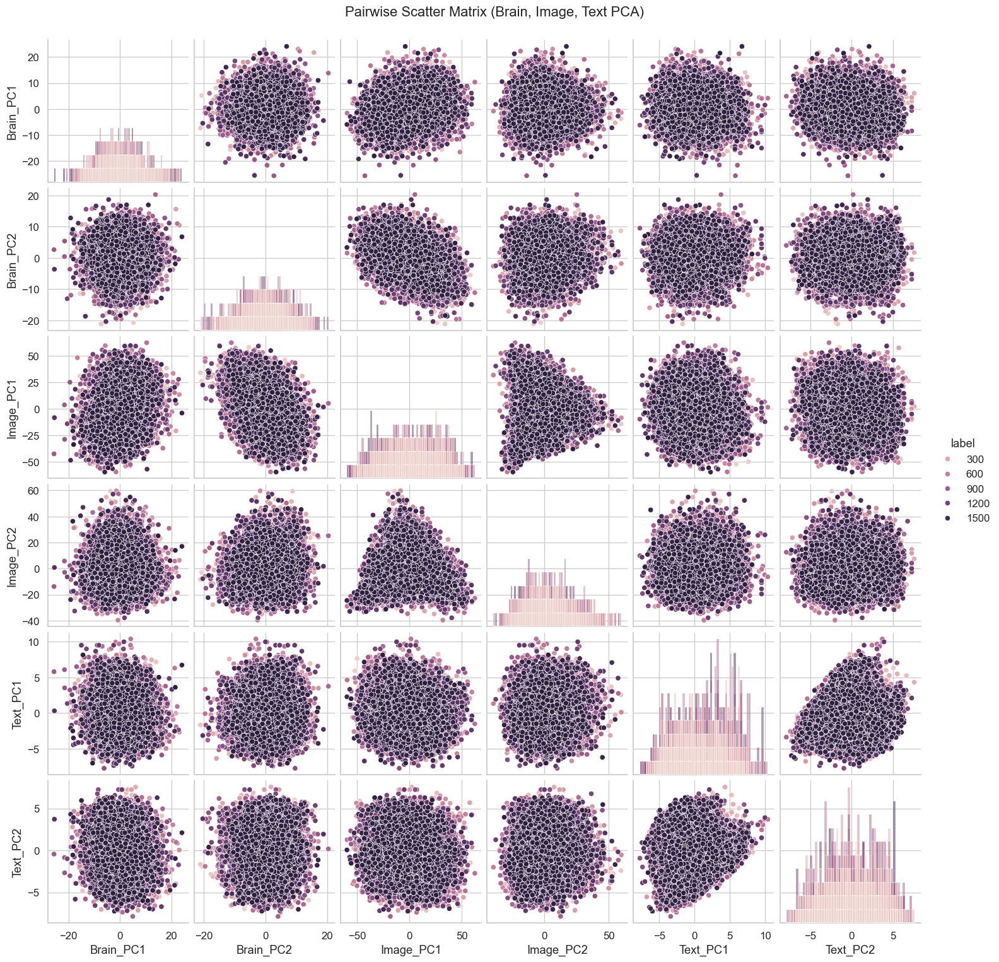

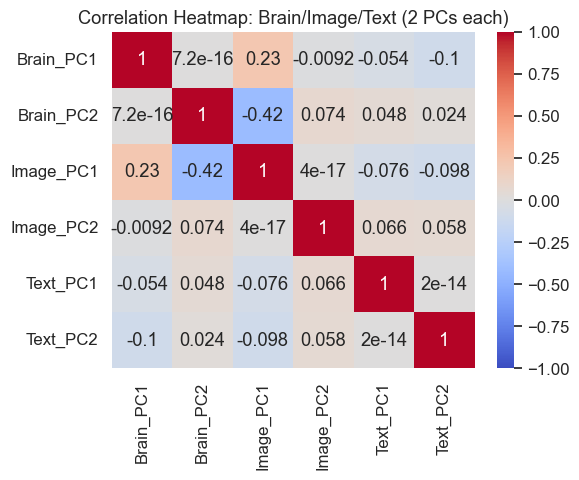

In [74]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA

# ------------------------------------------------------------------
# 1. Prepare your data
# ------------------------------------------------------------------
# Assume you have DataFrames:
#   df_brain_seen, df_image_seen, df_text_seen 
# Each has columns for the features and a "label" column for classes

brain_columns = [c for c in df_brain_seen.columns if c.startswith("brain_")]
image_columns = [c for c in df_image_seen.columns if c.startswith("image_")]
text_columns  = [c for c in df_text_seen.columns  if c.startswith("text_")]

brain_data = df_brain_seen[brain_columns].values  # shape: (N, #brain_features)
image_data = df_image_seen[image_columns].values  # shape: (N, #image_features)
text_data  = df_text_seen[text_columns].values    # shape: (N, #text_features)

labels = df_brain_seen["label"].values            # shape: (N,)

# ------------------------------------------------------------------
# 2. Reduce each modality to 2 PCA components
# ------------------------------------------------------------------
pca_dim = 2
pca_brain = PCA(n_components=pca_dim).fit_transform(brain_data)
pca_image = PCA(n_components=pca_dim).fit_transform(image_data)
pca_text  = PCA(n_components=pca_dim).fit_transform(text_data)

# pca_brain, pca_image, pca_text are each (N, 2)

# ------------------------------------------------------------------
# 3. Combine the 2D PCA embeddings into one DataFrame
# ------------------------------------------------------------------
df_pca_combined = pd.DataFrame({
    "Brain_PC1": pca_brain[:, 0],
    "Brain_PC2": pca_brain[:, 1],
    "Image_PC1": pca_image[:, 0],
    "Image_PC2": pca_image[:, 1],
    "Text_PC1":  pca_text[:, 0],
    "Text_PC2":  pca_text[:, 1],
    "label":     labels      # optional, for coloring by class
})

# ------------------------------------------------------------------
# 4. Create a scatterplot matrix (pairplot)
# ------------------------------------------------------------------
sns.set(style="whitegrid", font_scale=1.1)

# If you want to color points by the label, use the `hue` parameter
g = sns.pairplot(df_pca_combined, 
                 vars=["Brain_PC1", "Brain_PC2", 
                       "Image_PC1", "Image_PC2", 
                       "Text_PC1",  "Text_PC2"],
                 hue="label",      # color by class label 
                 diag_kind="hist", # histogram on diagonal
                 corner=False)     # if True, only lower triangle

g.fig.suptitle("Pairwise Scatter Matrix (Brain, Image, Text PCA)", y=1.02)
plt.show()

# ------------------------------------------------------------------
# 5. (Optional) Correlation Heatmap of these 6 PC variables
# ------------------------------------------------------------------
corr_matrix = df_pca_combined[["Brain_PC1","Brain_PC2",
                               "Image_PC1","Image_PC2",
                               "Text_PC1","Text_PC2"]].corr()

plt.figure(figsize=(6,5))
sns.heatmap(corr_matrix, annot=True, vmin=-1, vmax=1, cmap="coolwarm")
plt.title("Correlation Heatmap: Brain/Image/Text (2 PCs each)")
plt.tight_layout()
plt.show()

In [77]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.manifold import TSNE


In [78]:
# Brain features
brain_columns = [c for c in df_brain_seen.columns if c.startswith('brain_')]
brain_data = df_brain_seen[brain_columns].values
brain_labels = df_brain_seen["label"].values

# Image features
image_columns = [c for c in df_image_seen.columns if c.startswith('image_')]
image_data = df_image_seen[image_columns].values
image_labels = df_image_seen["label"].values

# Text features
text_columns = [c for c in df_text_seen.columns if c.startswith('text_')]
text_data = df_text_seen[text_columns].values
text_labels = df_text_seen["label"].values

print("Brain data shape:", brain_data.shape)
print("Image data shape:", image_data.shape)
print("Text data shape: ", text_data.shape)

Brain data shape: (16540, 561)
Image data shape: (16540, 100)
Text data shape:  (16540, 512)


In [83]:
max_samples = 10000

if brain_data.shape[0] > max_samples:
    idx = np.random.choice(brain_data.shape[0], max_samples, replace=False)
    brain_data = brain_data[idx]
    brain_labels = brain_labels[idx]
    
if image_data.shape[0] > max_samples:
    idx = np.random.choice(image_data.shape[0], max_samples, replace=False)
    image_data = image_data[idx]
    image_labels = image_labels[idx]

if text_data.shape[0] > max_samples:
    idx = np.random.choice(text_data.shape[0], max_samples, replace=False)
    text_data = text_data[idx]
    text_labels = text_labels[idx]

In [84]:
tsne_brain = TSNE(n_components=2, perplexity=30, random_state=42)
brain_tsne_2d = tsne_brain.fit_transform(brain_data)   # shape (N, 2)

tsne_image = TSNE(n_components=2, perplexity=30, random_state=42)
image_tsne_2d = tsne_image.fit_transform(image_data)

tsne_text = TSNE(n_components=2, perplexity=30, random_state=42)
text_tsne_2d = tsne_text.fit_transform(text_data)

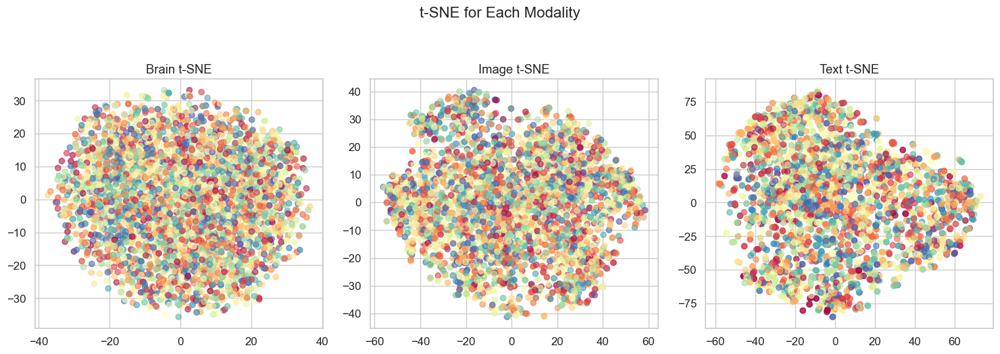

In [85]:
sns.set(style="whitegrid", font_scale=1.1)

fig, axes = plt.subplots(1, 3, figsize=(15, 5))

axes[0].scatter(brain_tsne_2d[:,0], brain_tsne_2d[:,1], 
                c=brain_labels, alpha=0.6, cmap="Spectral")
axes[0].set_title("Brain t-SNE")

axes[1].scatter(image_tsne_2d[:,0], image_tsne_2d[:,1], 
                c=image_labels, alpha=0.6, cmap="Spectral")
axes[1].set_title("Image t-SNE")

axes[2].scatter(text_tsne_2d[:,0], text_tsne_2d[:,1], 
                c=text_labels, alpha=0.6, cmap="Spectral")
axes[2].set_title("Text t-SNE")

plt.suptitle("t-SNE for Each Modality", y=1.05, fontsize=16)
plt.tight_layout()
plt.show()

Combined shape: (3000, 1173)


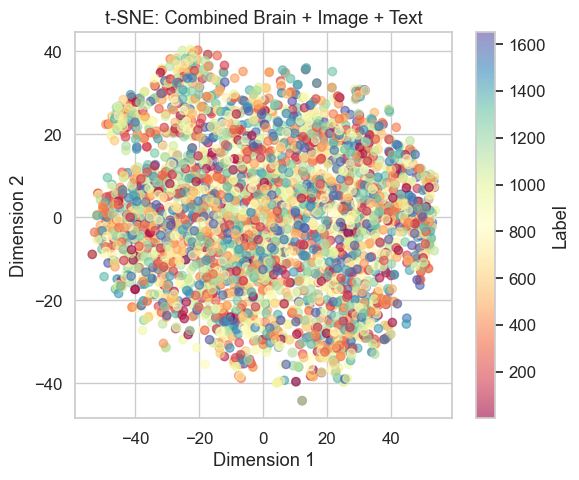

In [86]:
combined_data = np.hstack([brain_data, image_data, text_data])
combined_labels = brain_labels  # or whichever is your "master" label set

print("Combined shape:", combined_data.shape)

tsne_combined = TSNE(n_components=2, perplexity=30, random_state=42)
combined_tsne_2d = tsne_combined.fit_transform(combined_data)

plt.figure(figsize=(6, 5))
plt.scatter(combined_tsne_2d[:, 0], combined_tsne_2d[:, 1], 
            c=combined_labels, alpha=0.6, cmap="Spectral")
plt.title("t-SNE: Combined Brain + Image + Text")
plt.xlabel("Dimension 1")
plt.ylabel("Dimension 2")
plt.colorbar(label="Label")
plt.tight_layout()
plt.show()

# Exploration of the data set 

Through in-depth exploration, you can discover hidden patterns, outliers, distribution differences and other problems in the data, which helps to better perform feature engineering, model selection and tuning. In-depth analysis can also help you avoid potential biases or data leakage and improve the performance and robustness of the model.

Statistical analyis 

In [43]:
import pandas as pd
# Convert tensors to numpy arrays
brain_seen_np = brain_seen.numpy()
brain_unseen_np = brain_unseen.numpy()
image_seen_np = image_seen.numpy()
image_unseen_np = image_unseen.numpy()
text_seen_np = text_seen.numpy()
text_unseen_np = text_unseen.numpy()
label_seen_np = label_seen.numpy()
label_unseen_np = label_unseen.numpy()

# Convert numpy arrays to pandas DataFrames
brain_seen_df = pd.DataFrame(brain_seen_np)
brain_unseen_df = pd.DataFrame(brain_unseen_np)
image_seen_df = pd.DataFrame(image_seen_np)
image_unseen_df = pd.DataFrame(image_unseen_np)
text_seen_df = pd.DataFrame(text_seen_np)
text_unseen_df = pd.DataFrame(text_unseen_np)
label_seen_df = pd.DataFrame(label_seen_np, columns=['label'])
label_unseen_df = pd.DataFrame(label_unseen_np, columns=['label'])

# Display summary statistics
print("Brain Seen Summary Statistics:")
print(brain_seen_df.describe())
print("\nBrain Unseen Summary Statistics:")
print(brain_unseen_df.describe())
print("\nImage Seen Summary Statistics:")
print(image_seen_df.describe())
print("\nImage Unseen Summary Statistics:")
print(image_unseen_df.describe())
print("\nText Seen Summary Statistics:")
print(text_seen_df.describe())
print("\nText Unseen Summary Statistics:")
print(text_unseen_df.describe())
print("\nLabel Seen Summary Statistics:")
print(label_seen_df.describe())
print("\nLabel Unseen Summary Statistics:")
print(label_unseen_df.describe())

Brain Seen Summary Statistics:
                0             1             2             3             4    \
count  16540.000000  16540.000000  16540.000000  16540.000000  16540.000000   
mean       0.076787      0.070698      0.028373     -0.044438     -0.067034   
std        0.583893      0.592233      0.610593      0.630831      0.641200   
min       -2.762807     -2.598095     -2.349412     -2.818633     -3.008686   
25%       -0.309925     -0.320417     -0.378459     -0.459167     -0.493376   
50%        0.072401      0.068746      0.033988     -0.046756     -0.061193   
75%        0.464845      0.459148      0.433262      0.374403      0.357285   
max        2.293334      2.570706      2.949977      2.507507      2.499492   

                5             6             7             8             9    \
count  16540.000000  16540.000000  16540.000000  16540.000000  16540.000000   
mean      -0.127158     -0.140791     -0.122330     -0.069163     -0.012199   
std        0.646158 

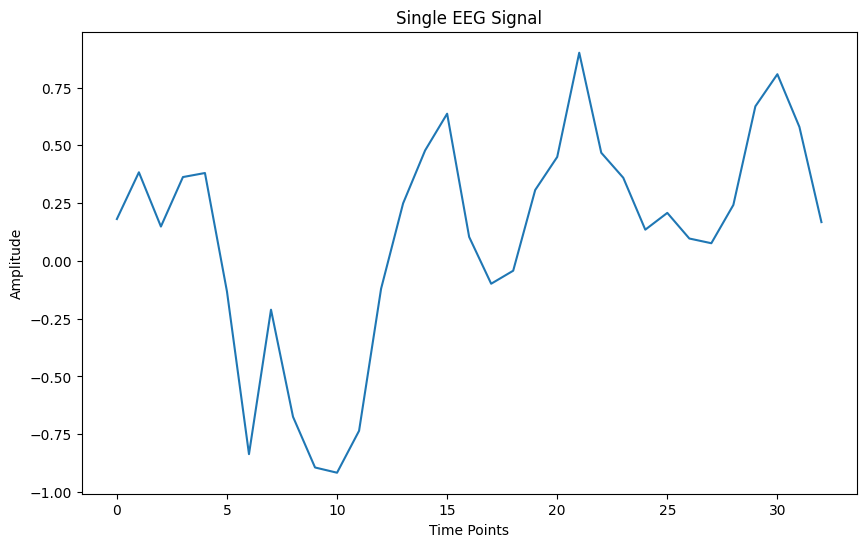

In [44]:
import os
import scipy.io as sio
import numpy as np
import matplotlib.pyplot as plt

# Load data
data_dir_root = os.path.join('./data', 'ThingsEEG-Text')
sbj = 'sub-10'
roi = '17channels'
brain_dir = os.path.join(data_dir_root, 'brain_feature', roi, sbj)

brain_seen = sio.loadmat(os.path.join(brain_dir, 'eeg_train_data_within.mat'))['data'].astype('double') * 2.0
brain_seen = brain_seen[:,:,27:60] # 70ms-400ms

# Select a single EEG signal (e.g., the first signal)
single_eeg_signal = brain_seen[0, 0, :]

# Plot the EEG signal
plt.figure(figsize=(10, 6))
plt.plot(single_eeg_signal)
plt.title('Single EEG Signal')
plt.xlabel('Time Points')
plt.ylabel('Amplitude')
plt.show()

Number of samples per class:
class
1       90
2       90
3       90
4       90
5       90
        ..
1650    10
1651    10
1652    10
1653    10
1654    10
Name: count, Length: 1654, dtype: int64


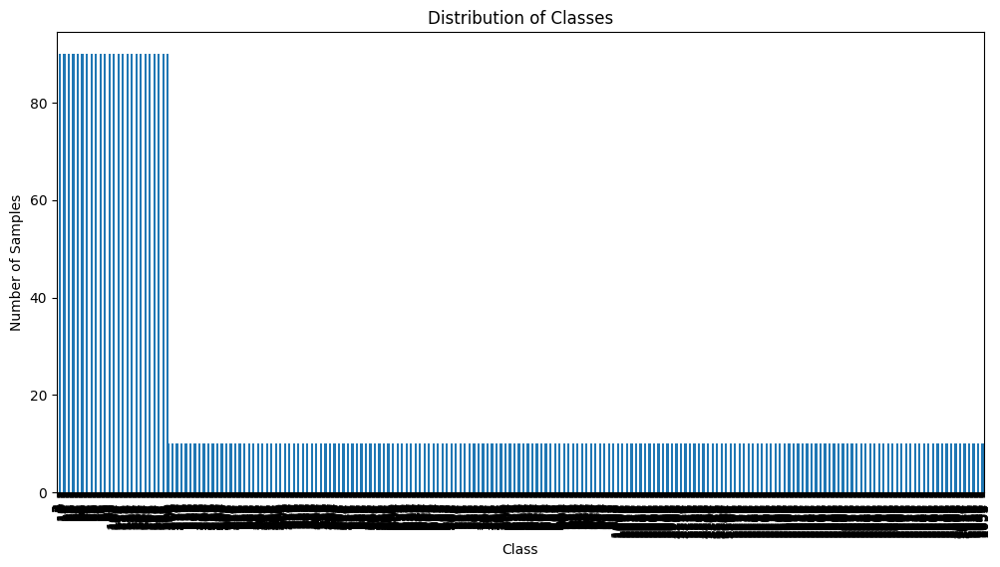

In [46]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


# Combine seen and unseen labels for overall distribution
all_labels = np.concatenate((label_seen.flatten(), label_unseen.flatten()))

# Create a DataFrame for easier manipulation
df = pd.DataFrame({'class': all_labels})

# Count the number of samples per class
class_counts = df['class'].value_counts().sort_index()

print("Number of samples per class:")
print(class_counts)

# Plot the distribution of classes
plt.figure(figsize=(12, 6))
class_counts.plot(kind='bar')
plt.title('Distribution of Classes')
plt.xlabel('Class')
plt.ylabel('Number of Samples')
plt.show()

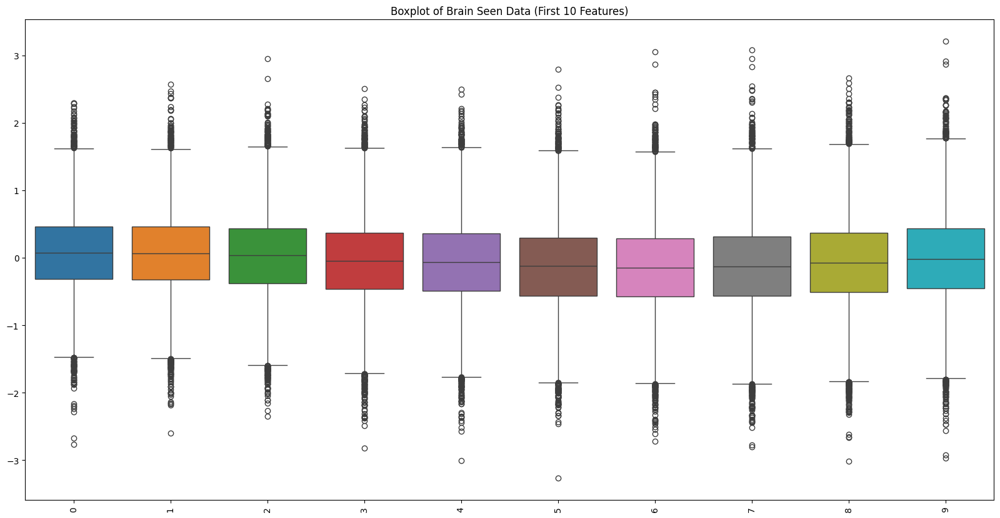

In [3]:
import matplotlib.pyplot as plt
import seaborn as sns

# Select a subset of features (e.g., first 10 features)
subset_features = brain_seen_df.iloc[:, :10]

# Create box plots for the subset of features
plt.figure(figsize=(20, 10))
sns.boxplot(data=subset_features)
plt.title('Boxplot of Brain Seen Data (First 10 Features)')
plt.xticks(rotation=90)
plt.show()

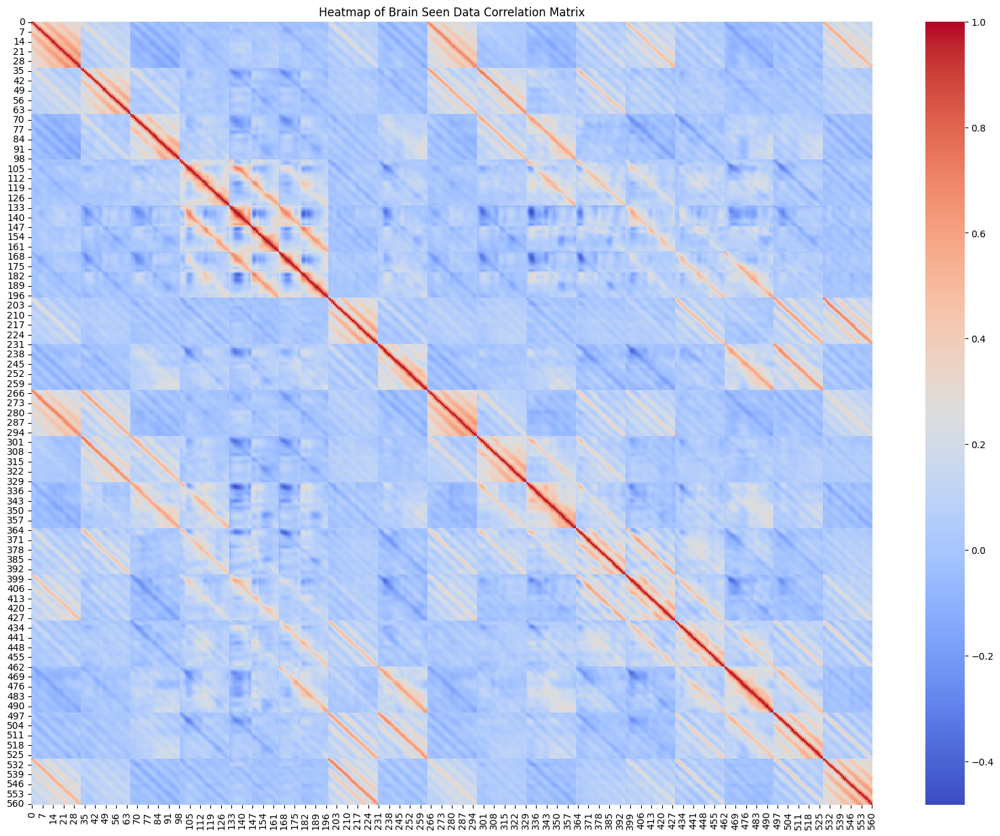

In [4]:
import matplotlib.pyplot as plt
import seaborn as sns

# Calculate the correlation matrix
correlation_matrix = brain_seen_df.corr()

# Create a heatmap
plt.figure(figsize=(20, 15))
sns.heatmap(correlation_matrix, annot=False, cmap='coolwarm')
plt.title('Heatmap of Brain Seen Data Correlation Matrix')
plt.show()

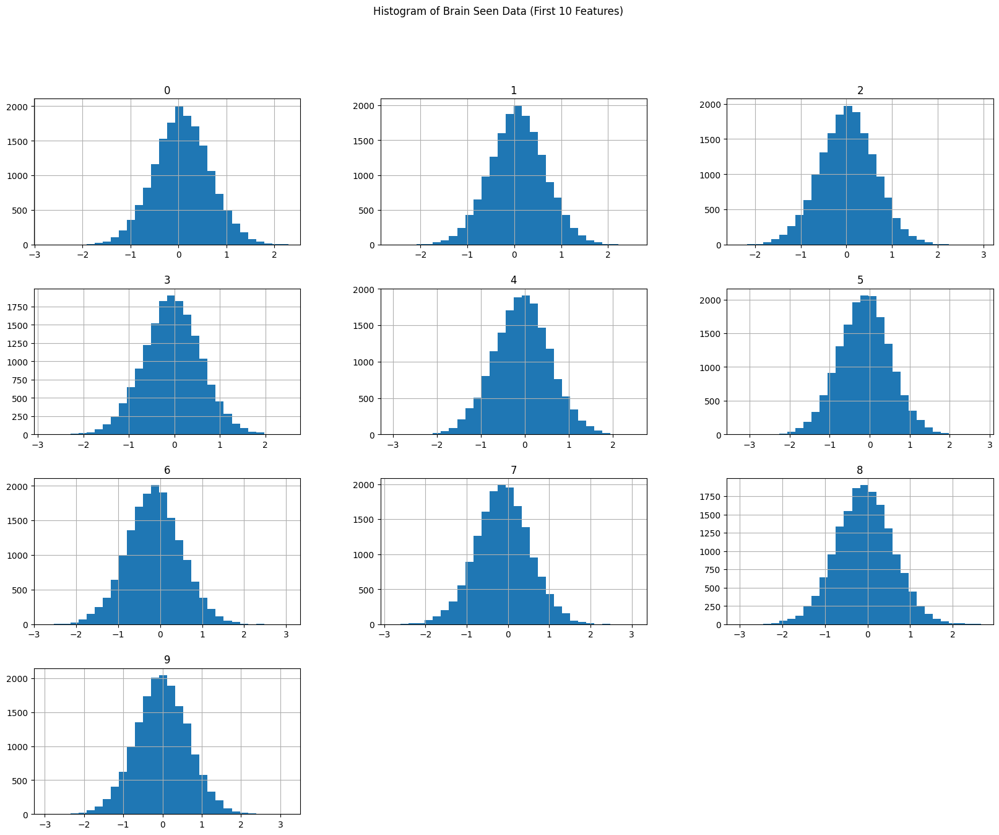

In [5]:
import matplotlib.pyplot as plt
import seaborn as sns

# Select a subset of features (e.g., first 10 features)
subset_features = brain_seen_df.iloc[:, :10]

# Plot histograms for the subset of features
subset_features.hist(bins=30, figsize=(20, 15))
plt.suptitle('Histogram of Brain Seen Data (First 10 Features)')
plt.show()

In [ ]:
# visual features

In [8]:
import pandas as pd

# Assuming image_seen_df is your DataFrame containing visual features data
# Generate summary statistics
summary_stats_visual = image_seen_df.describe()

# Calculate skewness and kurtosis
skewness_visual = image_seen_df.skew()
kurtosis_visual = image_seen_df.kurt()

# Add skewness and kurtosis to the summary statistics DataFrame
summary_stats_visual.loc['skewness'] = skewness_visual
summary_stats_visual.loc['kurtosis'] = kurtosis_visual

# Transpose the summary statistics for better readability
summary_stats_visual = summary_stats_visual.T

# Display the summary statistics
print(summary_stats_visual)

      count          mean        std         min        25%       50%  \
0   16540.0  7.021046e-07  18.957557  -59.812802 -12.886783 -0.325556   
1   16540.0  2.966813e-06  12.942754  -39.590445  -9.228849 -1.017976   
2   16540.0 -1.569032e-06  11.084600  -33.416805  -7.590265 -0.942980   
3   16540.0  6.019644e-06   9.851502  -30.789775  -6.798845 -0.638693   
4   16540.0  6.106160e-07   9.296208  -27.426794  -6.790418 -0.896458   
..      ...           ...        ...         ...        ...       ...   
95  16540.0  7.184104e-06   3.486825 -112.579918  -1.734244  0.016200   
96  16540.0  4.791779e-07   3.475307  -68.505102  -1.678387 -0.000587   
97  16540.0 -4.433221e-06   3.473198 -110.025823  -1.481213 -0.017364   
98  16540.0 -2.636208e-06   3.465329 -108.595514  -1.508234  0.002675   
99  16540.0  4.236137e-06   3.456919 -103.715813  -1.526998  0.018240   

          75%         max   skewness    kurtosis  
0   12.942444   62.499112   0.039758   -0.243871  
1    8.059964   59.70

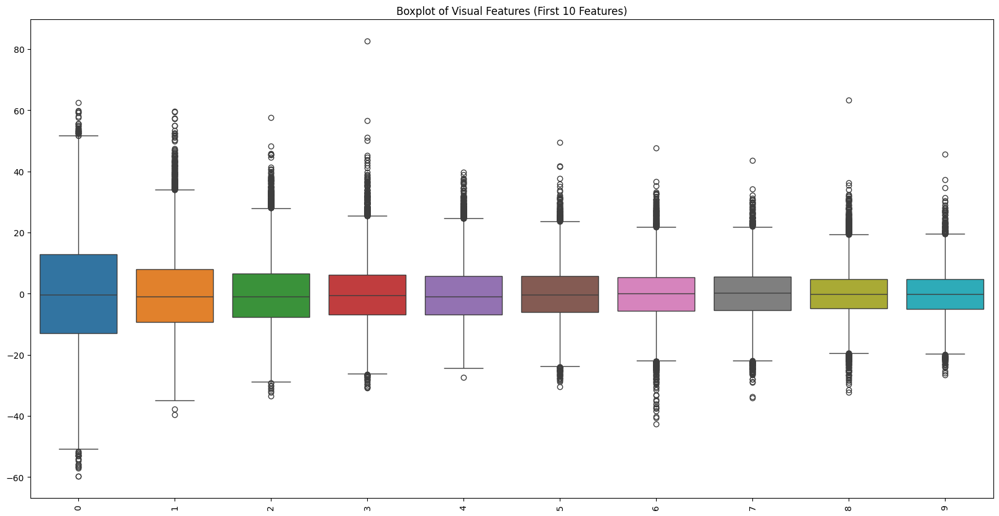

In [6]:
import matplotlib.pyplot as plt
import seaborn as sns

# Select a subset of features (e.g., first 10 features)
subset_visual_features = image_seen_df.iloc[:, :10]

# Create box plots for the subset of visual features
plt.figure(figsize=(20, 10))
sns.boxplot(data=subset_visual_features)
plt.title('Boxplot of Visual Features (First 10 Features)')
plt.xticks(rotation=90)
plt.show()

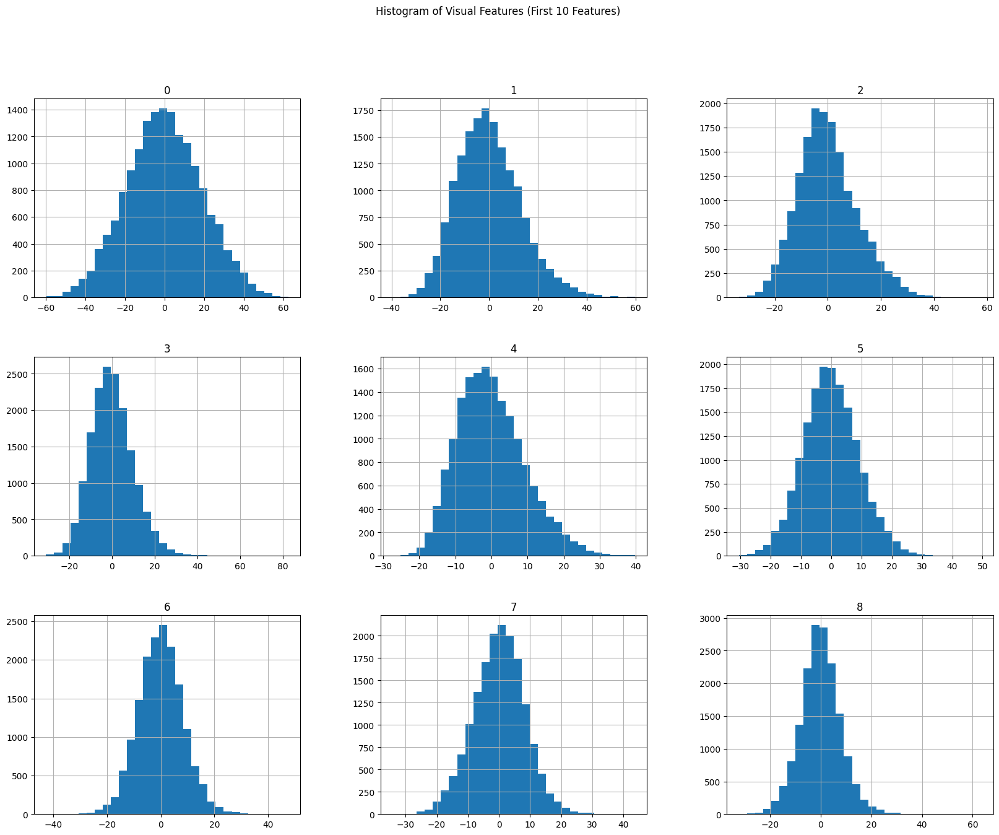

In [14]:
import matplotlib.pyplot as plt

# Select a subset of features (e.g., first 10 features)
subset_visual_features = image_seen_df.iloc[:, :9]

# Plot histograms for the subset of visual features
subset_visual_features.hist(bins=30, figsize=(20, 15))
plt.suptitle('Histogram of Visual Features (First 10 Features)')
plt.show()

In [ ]:
# textual features


In [9]:
import pandas as pd

# Assuming text_seen_df is your DataFrame containing textual features data
# Generate summary statistics
summary_stats_textual = text_seen_df.describe()

# Calculate skewness and kurtosis
skewness_textual = text_seen_df.skew()
kurtosis_textual = text_seen_df.kurt()

# Add skewness and kurtosis to the summary statistics DataFrame
summary_stats_textual.loc['skewness'] = skewness_textual
summary_stats_textual.loc['kurtosis'] = kurtosis_textual

# Transpose the summary statistics for better readability
summary_stats_textual = summary_stats_textual.T

# Display the summary statistics
print(summary_stats_textual)


       count      mean       std       min       25%       50%       75%  \
0    16540.0 -0.140649  0.427863 -1.872249 -0.426021 -0.149874  0.135171   
1    16540.0  0.202272  0.470689 -1.517790 -0.118238  0.216674  0.530111   
2    16540.0 -0.169746  0.433599 -1.714530 -0.471276 -0.183853  0.124185   
3    16540.0  0.082375  0.422881 -1.677265 -0.194574  0.089877  0.363391   
4    16540.0 -0.086476  0.460712 -1.790469 -0.405897 -0.102192  0.218988   
..       ...       ...       ...       ...       ...       ...       ...   
507  16540.0  0.137655  0.472045 -1.631194 -0.173856  0.141078  0.464332   
508  16540.0  0.043775  0.440177 -1.542941 -0.253117  0.048154  0.343921   
509  16540.0  0.226015  0.494423 -1.800649 -0.094379  0.238777  0.555316   
510  16540.0 -0.218999  0.457310 -1.800864 -0.521575 -0.204208  0.092678   
511  16540.0 -0.340320  0.525163 -2.841053 -0.698779 -0.346856  0.022997   

          max  skewness  kurtosis  
0    1.506855  0.116519  0.169471  
1    1.761805 -

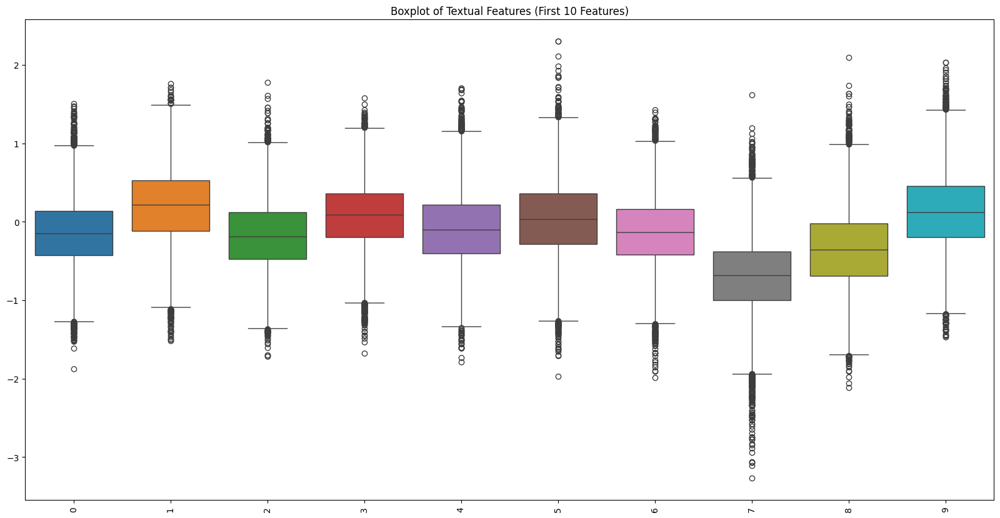

In [10]:
import matplotlib.pyplot as plt
import seaborn as sns

# Select a subset of features (e.g., first 10 features)
subset_textual_features = text_seen_df.iloc[:, :10]

# Create box plots for the subset of textual features
plt.figure(figsize=(20, 10))
sns.boxplot(data=subset_textual_features)
plt.title('Boxplot of Textual Features (First 10 Features)')
plt.xticks(rotation=90)
plt.show()

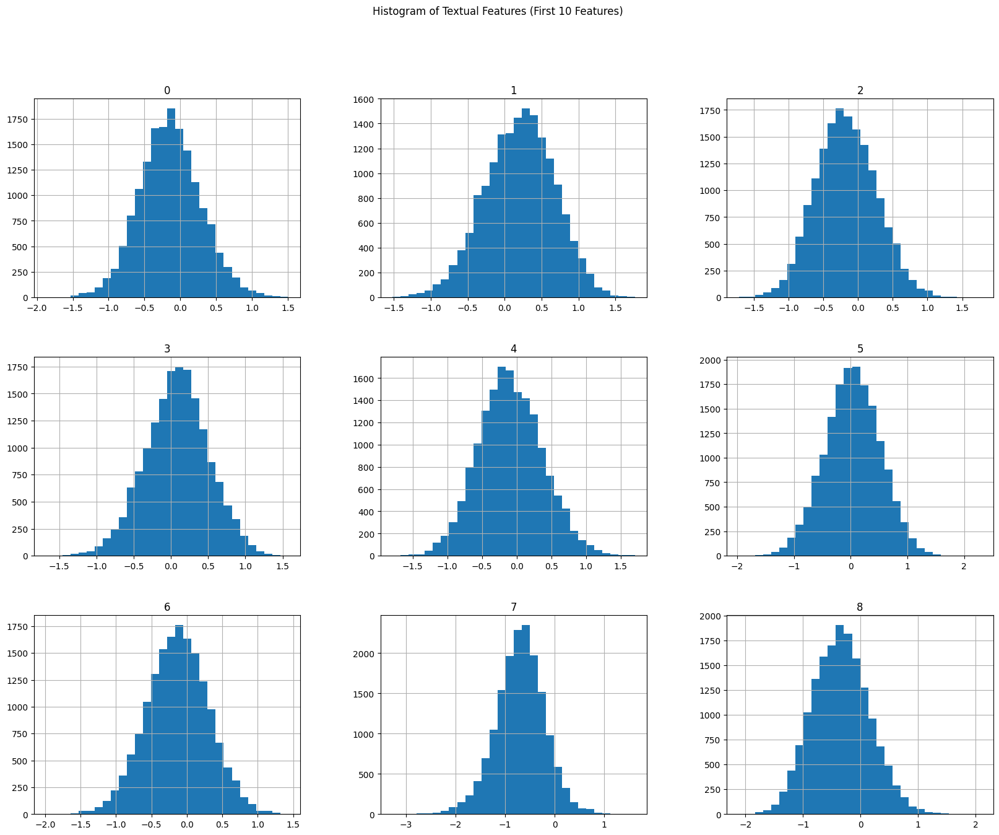

In [15]:
import matplotlib.pyplot as plt

# Select a subset of features (e.g., first 10 features)
subset_textual_features = text_seen_df.iloc[:, :9]

# Plot histograms for the subset of textual features
subset_textual_features.hist(bins=30, figsize=(20, 15))
plt.suptitle('Histogram of Textual Features (First 10 Features)')
plt.show()

label
1       90
139     90
129     90
130     90
131     90
        ..
682     10
681     10
680     10
679     10
1654    10
Name: count, Length: 1654, dtype: int64


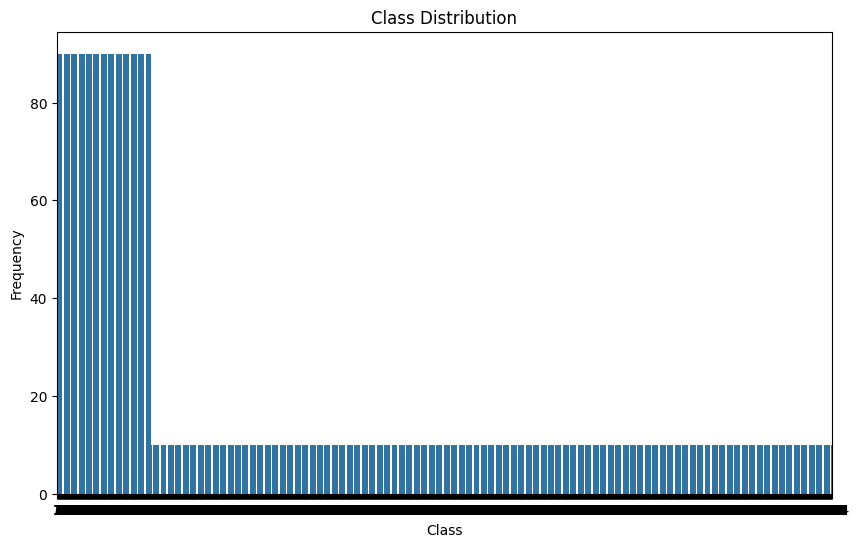

In [12]:
import torch
import os
import scipy.io as sio
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load data
data_dir_root = os.path.join('./data', 'ThingsEEG-Text')
sbj = 'sub-10'
brain_dir = os.path.join(data_dir_root, 'brain_feature', '17channels', sbj)

label_seen = sio.loadmat(os.path.join(brain_dir, 'eeg_train_data_within.mat'))['class_idx'].T.astype('int')
label_unseen = sio.loadmat(os.path.join(brain_dir, 'eeg_test_data.mat'))['class_idx'].T.astype('int')

# Convert labels to pandas DataFrame
label_seen_df = pd.DataFrame(label_seen, columns=['label'])
label_unseen_df = pd.DataFrame(label_unseen, columns=['label'])

# Combine seen and unseen labels
labels_df = pd.concat([label_seen_df, label_unseen_df])

# Check class distribution
class_counts = labels_df['label'].value_counts()

# Print class distribution
print(class_counts)

# Visualize class distribution
plt.figure(figsize=(10, 6))
sns.barplot(x=class_counts.index, y=class_counts.values)
plt.title('Class Distribution')
plt.xlabel('Class')
plt.ylabel('Frequency')
plt.show()

## correcting the data 

In [19]:
# Function to detect outliers using Z-score
def detect_outliers(df, threshold=3):
    z_scores = np.abs((df - df.mean()) / df.std())
    outliers = (z_scores > threshold).any(axis=1)
    num_outliers = outliers.sum()
    outlier_indices = np.where(outliers)[0]
    return num_outliers, outlier_indices

# Detect outliers for each modality
brain_outliers, brain_outlier_indices = detect_outliers(brain_seen_df)
image_outliers, image_outlier_indices = detect_outliers(image_seen_df)
text_outliers, text_outlier_indices = detect_outliers(text_seen_df)

# Print the results
print(f'Number of brain outliers: {brain_outliers}')
print(f'Indices of brain outliers: {brain_outlier_indices}')

print(f'Number of image outliers: {image_outliers}')
print(f'Indices of image outliers: {image_outlier_indices}')

print(f'Number of text outliers: {text_outliers}')
print(f'Indices of text outliers: {text_outlier_indices}')

Number of brain outliers: 8492
Indices of brain outliers: [    0     2     3 ... 16535 16537 16539]
Number of image outliers: 2400
Indices of image outliers: [   15    18    19 ... 16500 16525 16532]
Number of text outliers: 11504
Indices of text outliers: [    0     2     3 ... 16536 16537 16538]


In [23]:
from sklearn.preprocessing import RobustScaler
# Initialize RobustScaler
scaler = RobustScaler()

# Apply RobustScaler to each DataFrame
brain_seen_scaled = scaler.fit_transform(brain_seen_df)
image_seen_scaled = scaler.fit_transform(image_seen_df)
text_seen_scaled = scaler.fit_transform(text_seen_df)

# Convert scaled data to pandas DataFrames
brain_seen_scaled_df = pd.DataFrame(brain_seen_scaled, columns=brain_seen_df.columns)
image_seen_scaled_df = pd.DataFrame(image_seen_scaled, columns=image_seen_df.columns)
text_seen_scaled_df = pd.DataFrame(text_seen_scaled, columns=text_seen_df.columns)

# Print the shape of the scaled data
print(f'Scaled brain data shape: {brain_seen_scaled_df.shape}')
print(f'Scaled image data shape: {image_seen_scaled_df.shape}')
print(f'Scaled text data shape: {text_seen_scaled_df.shape}')

Scaled brain data shape: (16540, 561)
Scaled image data shape: (16540, 100)
Scaled text data shape: (16540, 512)


In [25]:
# Function to detect outliers using Z-score
def detect_outliers(df, threshold=4):
    z_scores = np.abs((df - df.mean()) / df.std())
    outliers = (z_scores > threshold).any(axis=1)
    num_outliers = outliers.sum()
    outlier_indices = np.where(outliers)[0]
    return num_outliers, outlier_indices

# Detect outliers for each modality
brain_outliers, brain_outlier_indices = detect_outliers(brain_seen_scaled_df)
image_outliers, image_outlier_indices = detect_outliers(image_seen_scaled_df)
text_outliers, text_outlier_indices = detect_outliers(text_seen_scaled_df)

# Print the results
print(f'Number of brain outliers: {brain_outliers}')


print(f'Number of image outliers: {image_outliers}')


print(f'Number of text outliers: {text_outliers}')


Number of brain outliers: 1010
Number of image outliers: 472
Number of text outliers: 629


In [37]:
from scipy.stats.mstats import winsorize
# Function to apply Winsorization
def apply_winsorization(df, limits=(0.005, 0.005)):
    return df.apply(lambda x: winsorize(x, limits=limits))

# Apply Winsorization to each DataFrame
brain_seen_winsorized = apply_winsorization(brain_seen_df)
image_seen_winsorized = apply_winsorization(image_seen_df)
text_seen_winsorized = apply_winsorization(text_seen_df)

In [38]:
from sklearn.preprocessing import RobustScaler
# Initialize RobustScaler
scaler = RobustScaler()

# Apply RobustScaler to each Winsorized DataFrame
brain_seen_scaled = scaler.fit_transform(brain_seen_winsorized)
image_seen_scaled = scaler.fit_transform(image_seen_winsorized)
text_seen_scaled = scaler.fit_transform(text_seen_winsorized)

# Convert scaled data back to DataFrame if needed
brain_seen_scaled_df = pd.DataFrame(brain_seen_scaled, columns=brain_seen_df.columns)
image_seen_scaled_df = pd.DataFrame(image_seen_scaled, columns=image_seen_df.columns)
text_seen_scaled_df = pd.DataFrame(text_seen_scaled, columns=text_seen_df.columns)

Visualise 

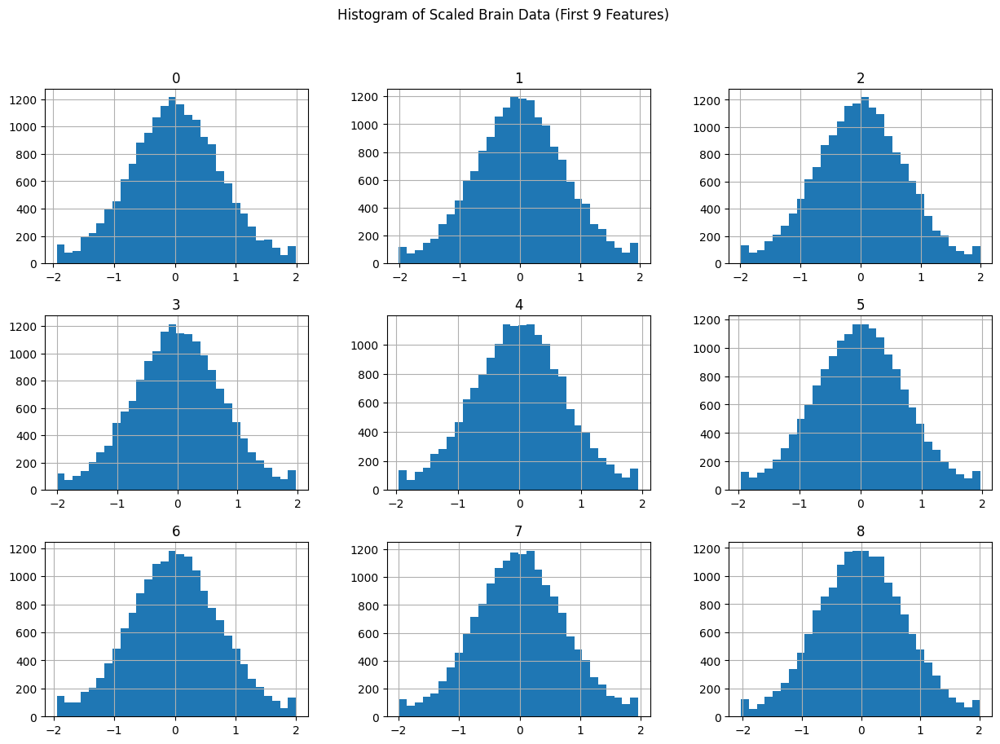

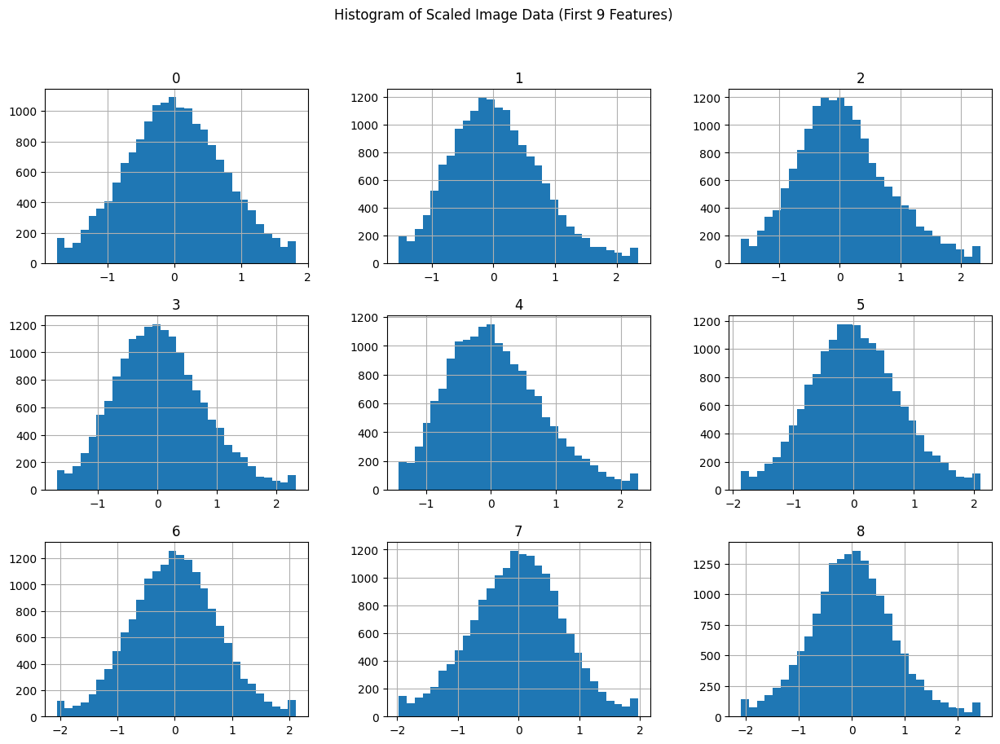

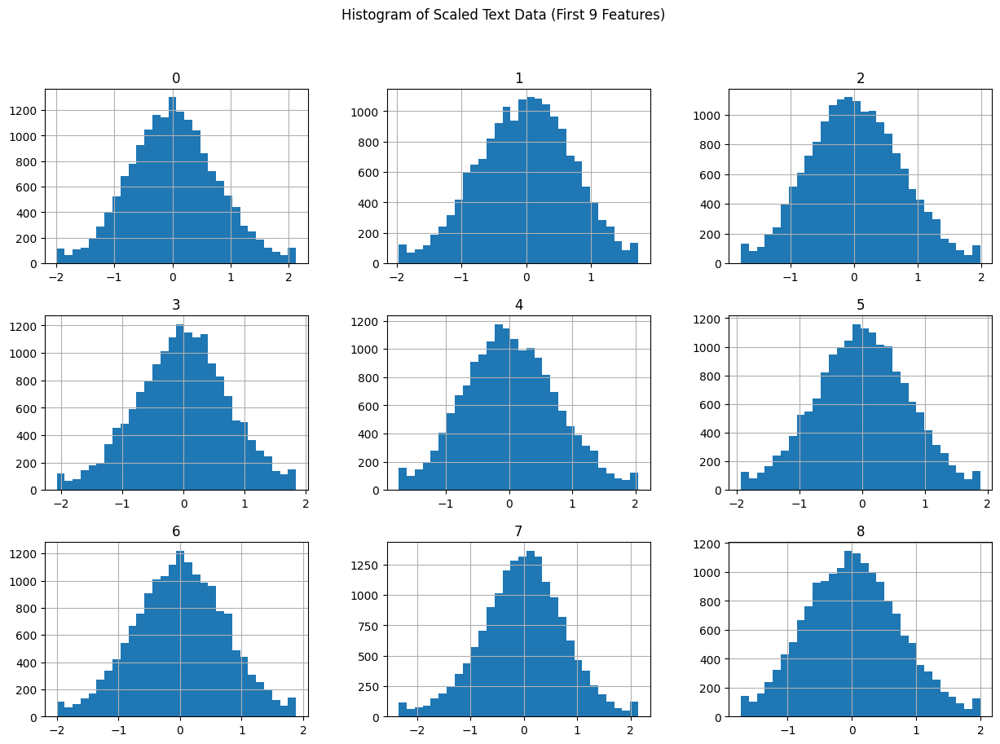

In [39]:
import matplotlib.pyplot as plt

# Plot histograms for the first 9 features
def plot_histograms(df, title):
    df.iloc[:, :9].hist(bins=30, figsize=(15, 10))
    plt.suptitle(title)
    plt.show()

plot_histograms(brain_seen_scaled_df, 'Histogram of Scaled Brain Data (First 9 Features)')
plot_histograms(image_seen_scaled_df, 'Histogram of Scaled Image Data (First 9 Features)')
plot_histograms(text_seen_scaled_df, 'Histogram of Scaled Text Data (First 9 Features)')

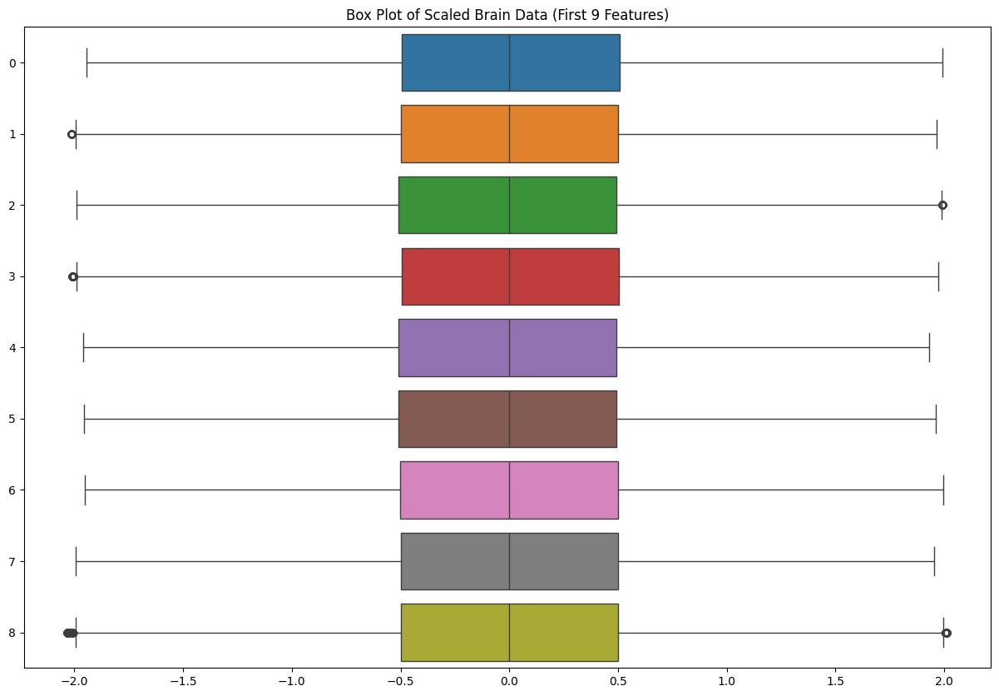

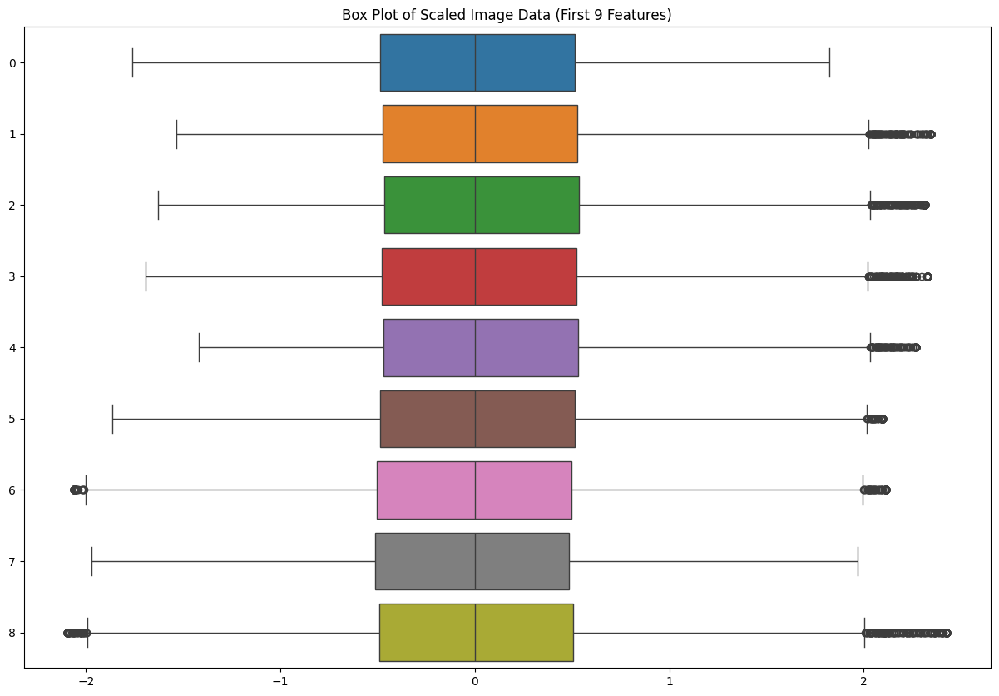

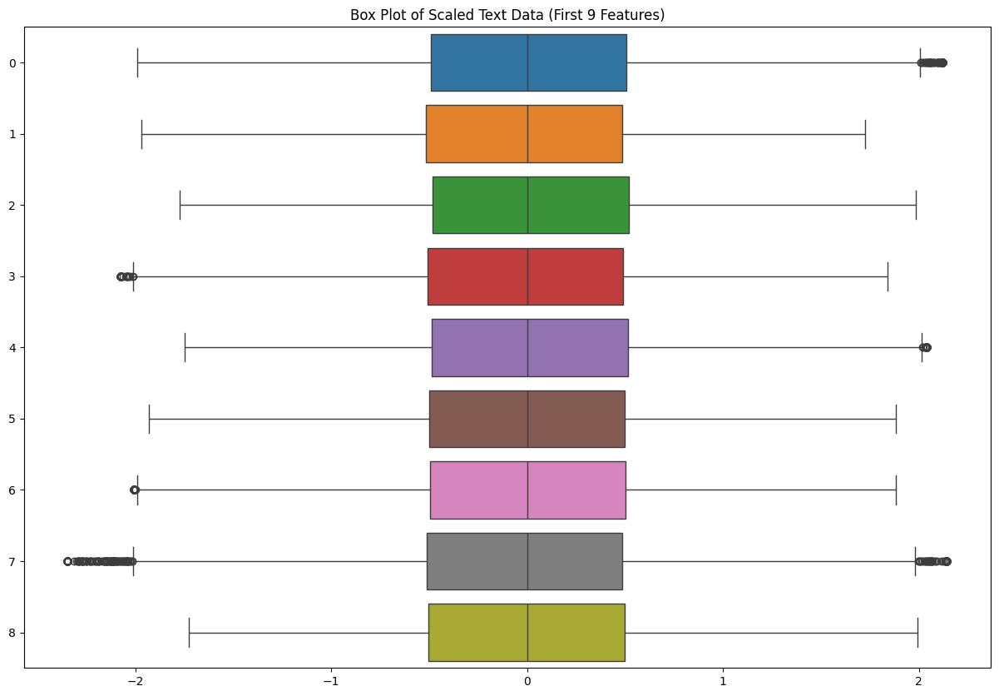

In [40]:
import seaborn as sns

# Plot box plots for the first 9 features
def plot_boxplots(df, title):
    plt.figure(figsize=(15, 10))
    sns.boxplot(data=df.iloc[:, :9], orient='h')
    plt.title(title)
    plt.show()

plot_boxplots(brain_seen_scaled_df, 'Box Plot of Scaled Brain Data (First 9 Features)')
plot_boxplots(image_seen_scaled_df, 'Box Plot of Scaled Image Data (First 9 Features)')
plot_boxplots(text_seen_scaled_df, 'Box Plot of Scaled Text Data (First 9 Features)')

/var/folders/fg/6yv7dd5s2xj427fzbf0__bmw0000gn/T/ipykernel_55834/1267113743.py:5: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(df[column], shade=True, label=column)
/var/folders/fg/6yv7dd5s2xj427fzbf0__bmw0000gn/T/ipykernel_55834/1267113743.py:5: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(df[column], shade=True, label=column)
/var/folders/fg/6yv7dd5s2xj427fzbf0__bmw0000gn/T/ipykernel_55834/1267113743.py:5: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(df[column], shade=True, label=column)
/var/folders/fg/6yv7dd5s2xj427fzbf0__bmw0000gn/T/ipykernel_55834/1267113743.py:5: FutureWarning: 

`shade` is now deprecated in fa

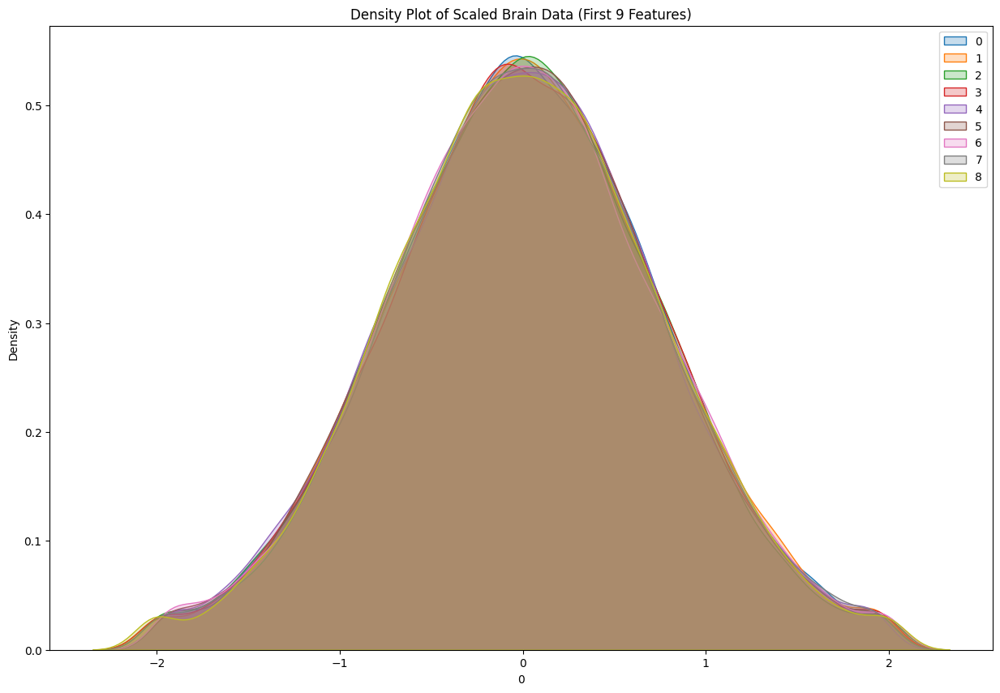

/var/folders/fg/6yv7dd5s2xj427fzbf0__bmw0000gn/T/ipykernel_55834/1267113743.py:5: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(df[column], shade=True, label=column)
/var/folders/fg/6yv7dd5s2xj427fzbf0__bmw0000gn/T/ipykernel_55834/1267113743.py:5: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(df[column], shade=True, label=column)
/var/folders/fg/6yv7dd5s2xj427fzbf0__bmw0000gn/T/ipykernel_55834/1267113743.py:5: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(df[column], shade=True, label=column)
/var/folders/fg/6yv7dd5s2xj427fzbf0__bmw0000gn/T/ipykernel_55834/1267113743.py:5: FutureWarning: 

`shade` is now deprecated in fa

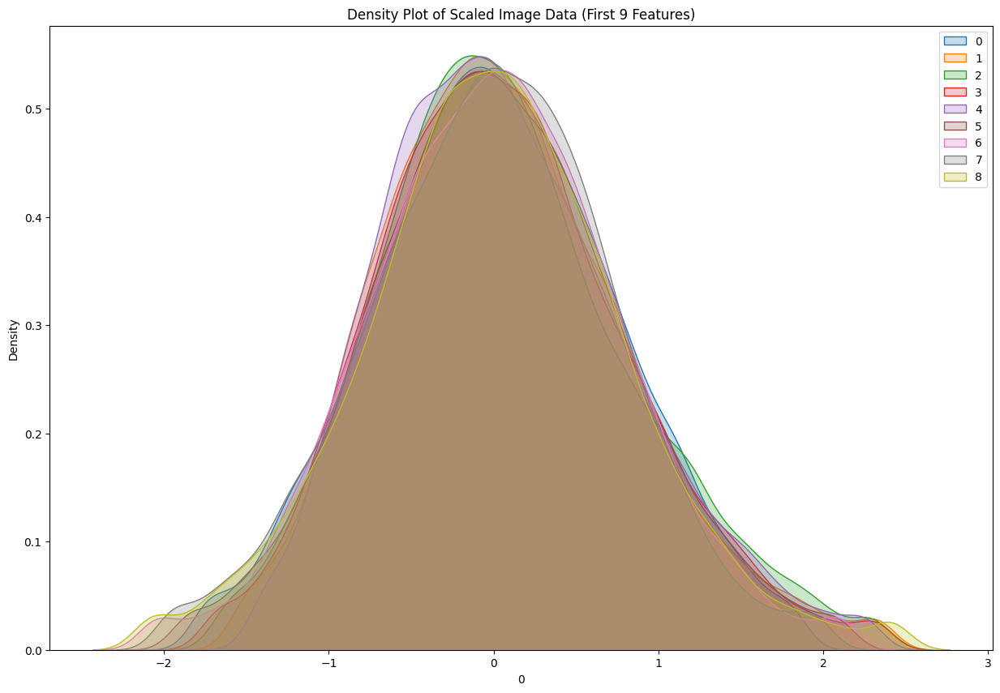

/var/folders/fg/6yv7dd5s2xj427fzbf0__bmw0000gn/T/ipykernel_55834/1267113743.py:5: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(df[column], shade=True, label=column)
/var/folders/fg/6yv7dd5s2xj427fzbf0__bmw0000gn/T/ipykernel_55834/1267113743.py:5: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(df[column], shade=True, label=column)
/var/folders/fg/6yv7dd5s2xj427fzbf0__bmw0000gn/T/ipykernel_55834/1267113743.py:5: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(df[column], shade=True, label=column)
/var/folders/fg/6yv7dd5s2xj427fzbf0__bmw0000gn/T/ipykernel_55834/1267113743.py:5: FutureWarning: 

`shade` is now deprecated in fa

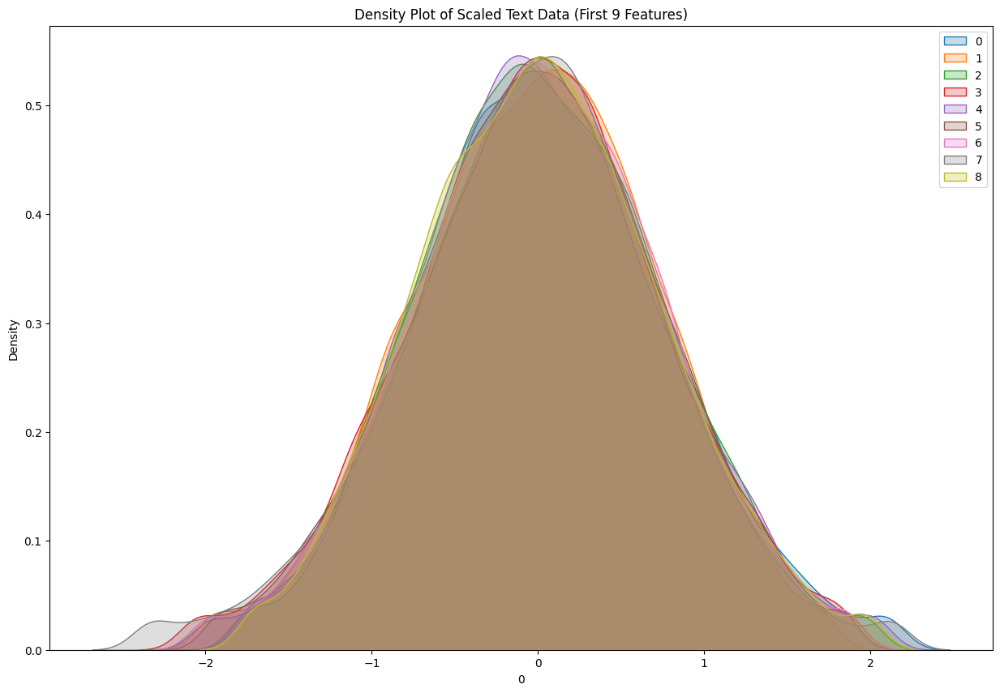

In [41]:
# Plot density plots for the first 9 features
def plot_density(df, title):
    plt.figure(figsize=(15, 10))
    for column in df.columns[:9]:
        sns.kdeplot(df[column], shade=True, label=column)
    plt.title(title)
    plt.legend()
    plt.show()

plot_density(brain_seen_scaled_df, 'Density Plot of Scaled Brain Data (First 9 Features)')
plot_density(image_seen_scaled_df, 'Density Plot of Scaled Image Data (First 9 Features)')
plot_density(text_seen_scaled_df, 'Density Plot of Scaled Text Data (First 9 Features)')

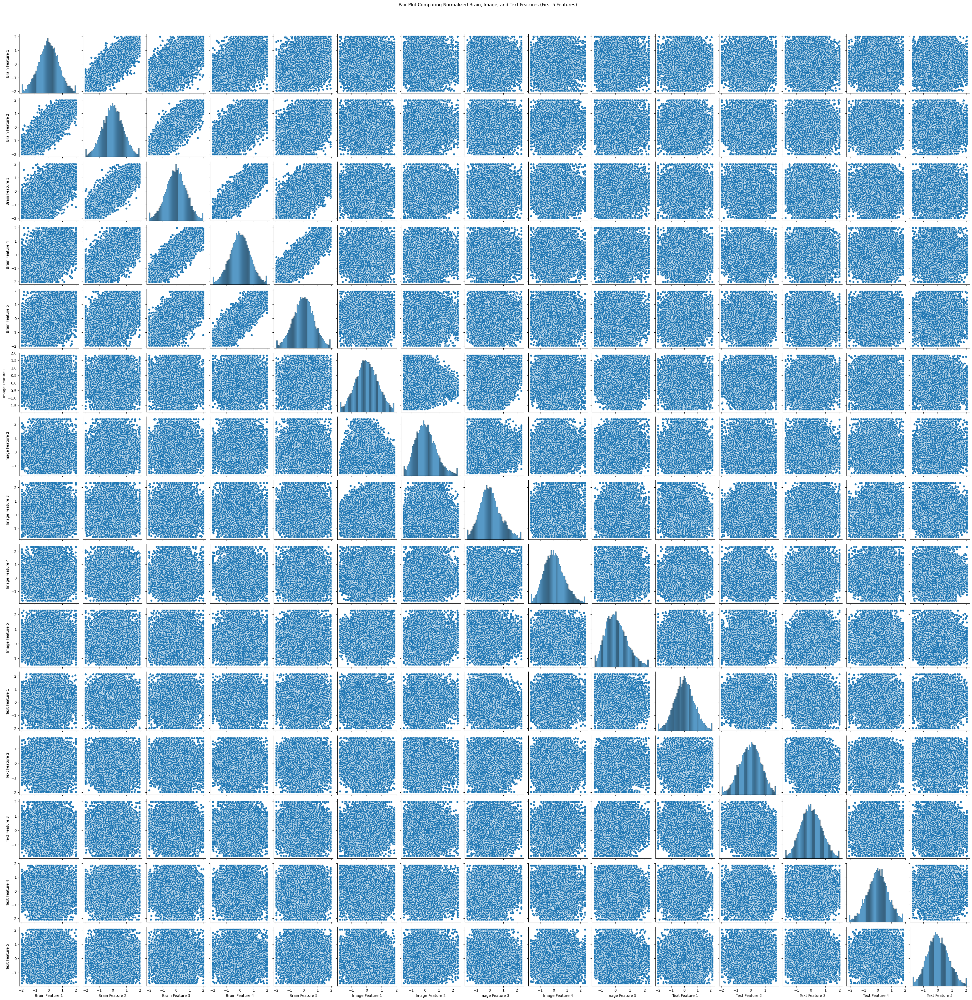

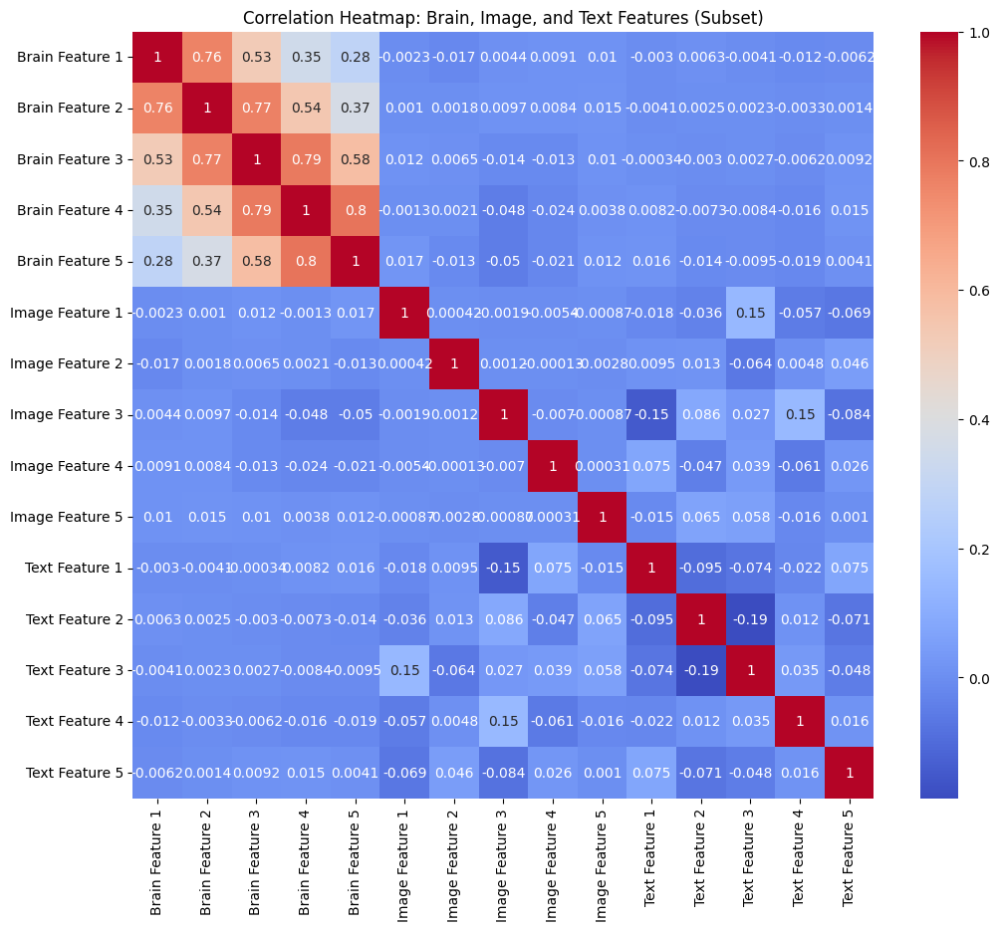

In [42]:
import seaborn as sns

# Combine the normalized data into a single DataFrame for pair plot
combined_df = pd.concat([brain_seen_scaled_df.iloc[:, :5], 
                         image_seen_scaled_df.iloc[:, :5], 
                         text_seen_scaled_df.iloc[:, :5]], axis=1)
combined_df.columns = [f'Brain Feature {i+1}' for i in range(5)] + \
                      [f'Image Feature {i+1}' for i in range(5)] + \
                      [f'Text Feature {i+1}' for i in range(5)]

# Create pair plot
sns.pairplot(combined_df)
plt.suptitle('Pair Plot Comparing Normalized Brain, Image, and Text Features (First 5 Features)', y=1.02)
plt.show()

# 2. Correlation Heatmap
correlations = combined_df.corr()
plt.figure(figsize=(12, 10))
sns.heatmap(correlations, annot=True, cmap='coolwarm')
plt.title("Correlation Heatmap: Brain, Image, and Text Features (Subset)")
plt.show()

Number of components to reach 95% variance: 175


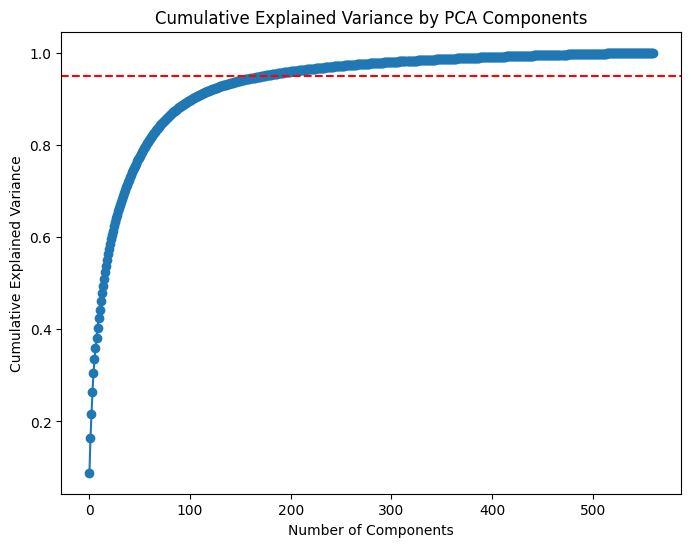

Shape of transformed data with 175 components: (16540, 175)


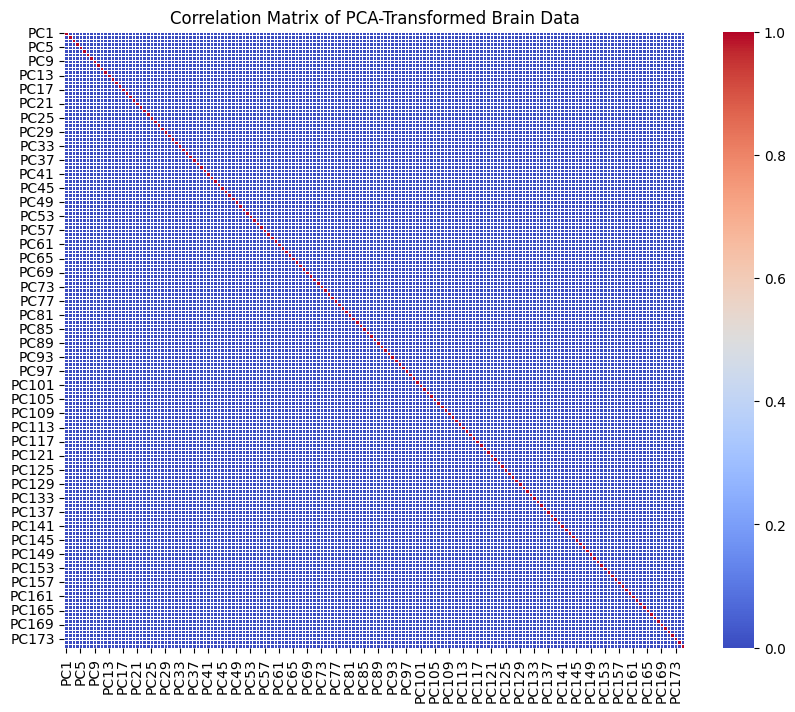

In [47]:

pca_full = PCA()
pca_full.fit(brain_seen_scaled_df)

# 3. Calculate cumulative explained variance
cumulative_variance = np.cumsum(pca_full.explained_variance_ratio_)

# 4. Find the number of components that covers 95% variance
n_components_95 = np.argmax(cumulative_variance >= 0.95) + 1
print(f"Number of components to reach 95% variance: {n_components_95}")

# (Optional) Visualize the cumulative explained variance
plt.figure(figsize=(8, 6))
plt.plot(cumulative_variance, marker='o')
plt.axhline(y=0.95, color='r', linestyle='--')
plt.title('Cumulative Explained Variance by PCA Components')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.show()

# 5. Re-run PCA using the number of components that covers 95% variance
pca_95 = PCA(n_components=n_components_95)
brain_pca_95 = pca_95.fit_transform(brain_seen_scaled_df)

print(f"Shape of transformed data with {n_components_95} components: {brain_pca_95.shape}")

# 6. Convert the PCA-transformed data to a DataFrame
brain_pca_95_df = pd.DataFrame(brain_pca_95, columns=[f'PC{i+1}' for i in range(n_components_95)])

# 7. Calculate the correlation matrix
correlation_matrix = brain_pca_95_df.corr()

# 8. Plot the correlation matrix as a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=False, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Matrix of PCA-Transformed Brain Data')
plt.show()

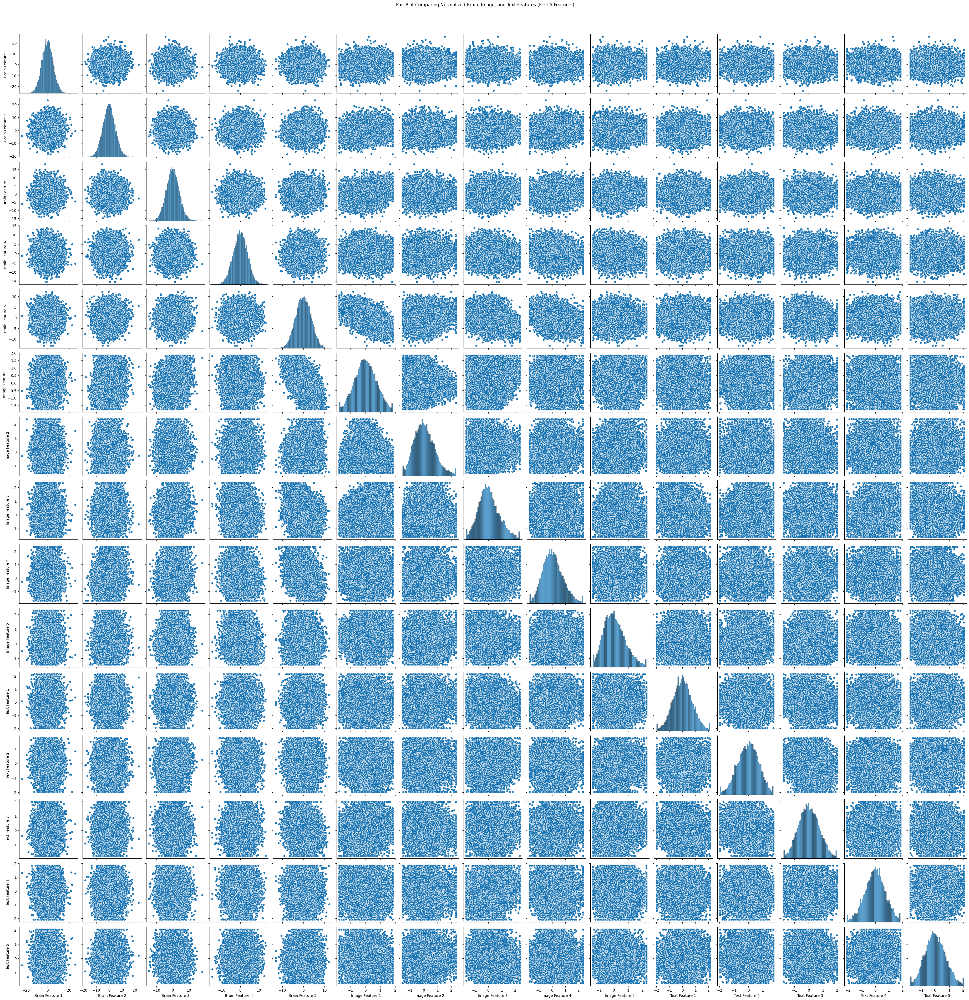

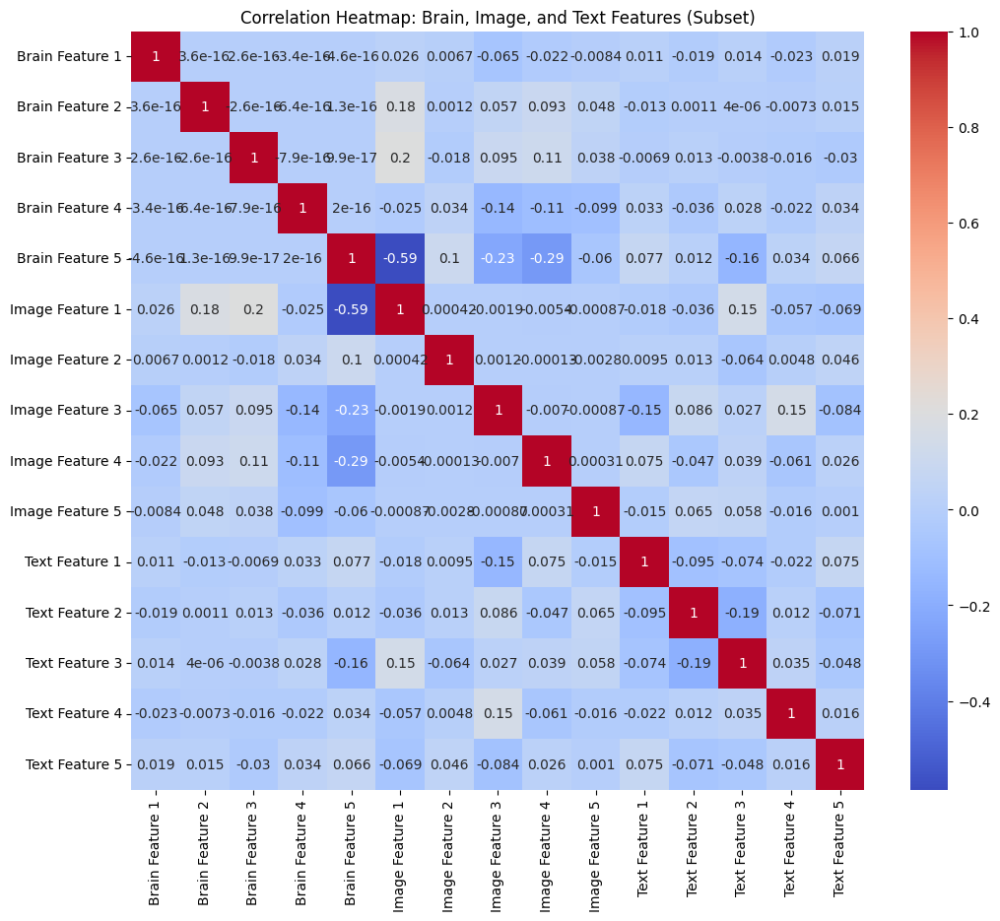

In [48]:
import seaborn as sns

# Combine the normalized data into a single DataFrame for pair plot
combined_df = pd.concat([brain_pca_95_df.iloc[:, :5], 
                         image_seen_scaled_df.iloc[:, :5], 
                         text_seen_scaled_df.iloc[:, :5]], axis=1)
combined_df.columns = [f'Brain Feature {i+1}' for i in range(5)] + \
                      [f'Image Feature {i+1}' for i in range(5)] + \
                      [f'Text Feature {i+1}' for i in range(5)]

# Create pair plot
sns.pairplot(combined_df)
plt.suptitle('Pair Plot Comparing Normalized Brain, Image, and Text Features (First 5 Features)', y=1.02)
plt.show()

# 2. Correlation Heatmap
correlations = combined_df.corr()
plt.figure(figsize=(12, 10))
sns.heatmap(correlations, annot=True, cmap='coolwarm')
plt.title("Correlation Heatmap: Brain, Image, and Text Features (Subset)")
plt.show()

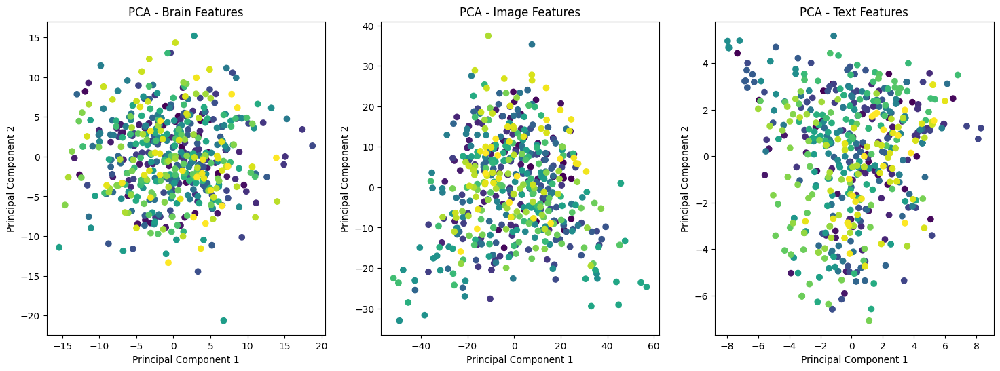

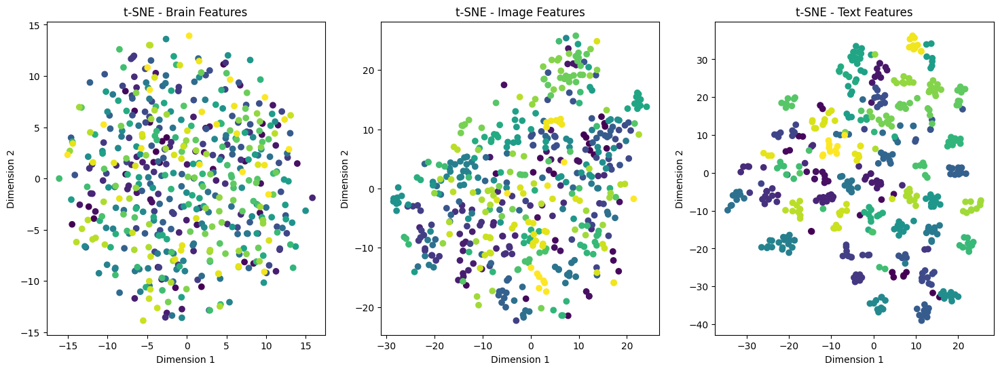

In [6]:
import os
import scipy.io as sio
import numpy as np
import torch
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

brain_seen_np = brain_seen.numpy()
image_seen_np = image_seen.numpy()
text_seen_np = text_seen.numpy()
label_seen_np = label_seen.numpy().flatten()

# Apply PCA to each modality
pca = PCA(n_components=2)
brain_pca = pca.fit_transform(brain_seen_np)
image_pca = pca.fit_transform(image_seen_np)
text_pca = pca.fit_transform(text_seen_np)

# Apply t-SNE to each modality (optional, for comparison)
tsne = TSNE(n_components=2, random_state=42)
brain_tsne = tsne.fit_transform(brain_seen_np)
image_tsne = tsne.fit_transform(image_seen_np)
text_tsne = tsne.fit_transform(text_seen_np)

# Plot PCA results
plt.figure(figsize=(18, 6))

plt.subplot(1, 3, 1)
plt.scatter(brain_pca[:, 0], brain_pca[:, 1], c=label_seen_np, cmap='viridis')
plt.title('PCA - Brain Features')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')

plt.subplot(1, 3, 2)
plt.scatter(image_pca[:, 0], image_pca[:, 1], c=label_seen_np, cmap='viridis')
plt.title('PCA - Image Features')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')

plt.subplot(1, 3, 3)
plt.scatter(text_pca[:, 0], text_pca[:, 1], c=label_seen_np, cmap='viridis')
plt.title('PCA - Text Features')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')

plt.show()

# Plot t-SNE results (optional)
plt.figure(figsize=(18, 6))

plt.subplot(1, 3, 1)
plt.scatter(brain_tsne[:, 0], brain_tsne[:, 1], c=label_seen_np, cmap='viridis')
plt.title('t-SNE - Brain Features')
plt.xlabel('Dimension 1')
plt.ylabel('Dimension 2')

plt.subplot(1, 3, 2)
plt.scatter(image_tsne[:, 0], image_tsne[:, 1], c=label_seen_np, cmap='viridis')
plt.title('t-SNE - Image Features')
plt.xlabel('Dimension 1')
plt.ylabel('Dimension 2')

plt.subplot(1, 3, 3)
plt.scatter(text_tsne[:, 0], text_tsne[:, 1], c=label_seen_np, cmap='viridis')
plt.title('t-SNE - Text Features')
plt.xlabel('Dimension 1')
plt.ylabel('Dimension 2')

plt.show()

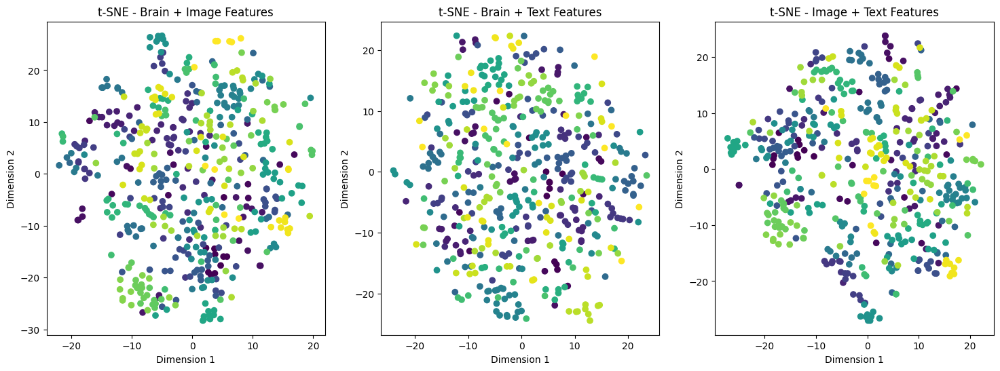

In [7]:
# Concatenate brain and image features
brain_image_combined = np.concatenate((brain_seen_np, image_seen_np), axis=1)

# Concatenate brain and text features
brain_text_combined = np.concatenate((brain_seen_np, text_seen_np), axis=1)

# Concatenate image and text features
image_text_combined = np.concatenate((image_seen_np, text_seen_np), axis=1)

# Apply t-SNE to the combined feature sets
tsne = TSNE(n_components=2, random_state=42)
brain_image_tsne = tsne.fit_transform(brain_image_combined)
brain_text_tsne = tsne.fit_transform(brain_text_combined)
image_text_tsne = tsne.fit_transform(image_text_combined)

# Plot t-SNE results for combined features
plt.figure(figsize=(18, 6))

plt.subplot(1, 3, 1)
plt.scatter(brain_image_tsne[:, 0], brain_image_tsne[:, 1], c=label_seen_np, cmap='viridis')
plt.title('t-SNE - Brain + Image Features')
plt.xlabel('Dimension 1')
plt.ylabel('Dimension 2')

plt.subplot(1, 3, 2)
plt.scatter(brain_text_tsne[:, 0], brain_text_tsne[:, 1], c=label_seen_np, cmap='viridis')
plt.title('t-SNE - Brain + Text Features')
plt.xlabel('Dimension 1')
plt.ylabel('Dimension 2')

plt.subplot(1, 3, 3)
plt.scatter(image_text_tsne[:, 0], image_text_tsne[:, 1], c=label_seen_np, cmap='viridis')
plt.title('t-SNE - Image + Text Features')
plt.xlabel('Dimension 1')
plt.ylabel('Dimension 2')

plt.show()

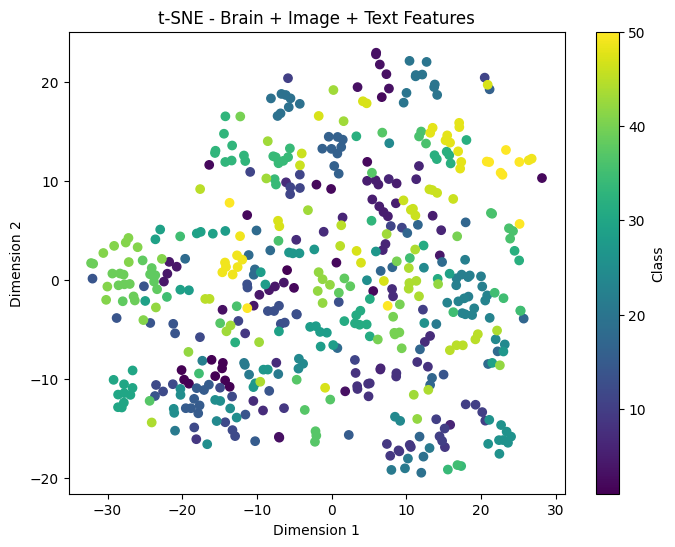

In [8]:
# Concatenate brain, image, and text features
combined_features = np.concatenate((brain_seen_np, image_seen_np, text_seen_np), axis=1)

# Apply t-SNE to the combined feature set
tsne = TSNE(n_components=2, random_state=42)
combined_tsne = tsne.fit_transform(combined_features)

# Plot t-SNE results for combined features
plt.figure(figsize=(8, 6))
plt.scatter(combined_tsne[:, 0], combined_tsne[:, 1], c=label_seen_np, cmap='viridis')
plt.title('t-SNE - Brain + Image + Text Features')
plt.xlabel('Dimension 1')
plt.ylabel('Dimension 2')
plt.colorbar(label='Class')
plt.show()

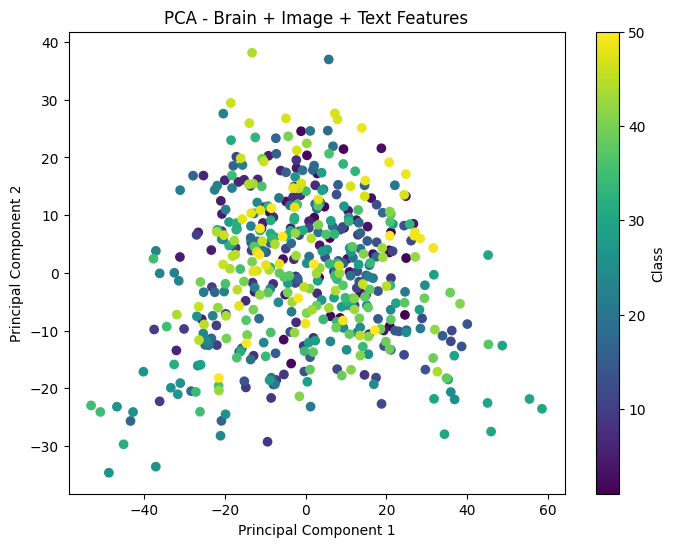

In [9]:
# Concatenate brain, image, and text features
combined_features = np.concatenate((brain_seen_np, image_seen_np, text_seen_np), axis=1)

# Apply PCA to the combined feature set
pca = PCA(n_components=2)
combined_pca = pca.fit_transform(combined_features)

# Plot PCA results for combined features
plt.figure(figsize=(8, 6))
plt.scatter(combined_pca[:, 0], combined_pca[:, 1], c=label_seen_np, cmap='viridis')
plt.title('PCA - Brain + Image + Text Features')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.colorbar(label='Class')
plt.show()

In [10]:
import torch
import torch.nn as nn
import torch.optim as optim

class Autoencoder(nn.Module):
    def __init__(self, input_dim, latent_dim):
        super(Autoencoder, self).__init__()
        self.encoder = nn.Sequential(
            nn.Linear(input_dim, 128),
            nn.ReLU(),
            nn.Linear(128, latent_dim)
        )
        self.decoder = nn.Sequential(
            nn.Linear(latent_dim, 128),
            nn.ReLU(),
            nn.Linear(128, input_dim),
            nn.Sigmoid()
        )

    def forward(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return encoded, decoded

# Define input and latent dimensions
input_dim = combined_features.shape[1]
latent_dim = 2  # For 2D visualization

# Initialize the autoencoder
autoencoder = Autoencoder(input_dim, latent_dim)

In [11]:
# Convert combined features to a PyTorch tensor
combined_features_tensor = torch.tensor(combined_features, dtype=torch.float32)

# Define loss function and optimizer
criterion = nn.MSELoss()
optimizer = optim.Adam(autoencoder.parameters(), lr=0.001)

# Training loop
num_epochs = 100
for epoch in range(num_epochs):
    autoencoder.train()
    optimizer.zero_grad()
    encoded, decoded = autoencoder(combined_features_tensor)
    loss = criterion(decoded, combined_features_tensor)
    loss.backward()
    optimizer.step()
    if (epoch + 1) % 10 == 0:
        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')

Epoch [10/100], Loss: 2.6419
Epoch [20/100], Loss: 2.4888
Epoch [30/100], Loss: 2.4742
Epoch [40/100], Loss: 2.4679
Epoch [50/100], Loss: 2.4634
Epoch [60/100], Loss: 2.4596
Epoch [70/100], Loss: 2.4565
Epoch [80/100], Loss: 2.4537
Epoch [90/100], Loss: 2.4514
Epoch [100/100], Loss: 2.4487


In [12]:
autoencoder.eval()
with torch.no_grad():
    encoded_features, _ = autoencoder(combined_features_tensor)
encoded_features_np = encoded_features.numpy()

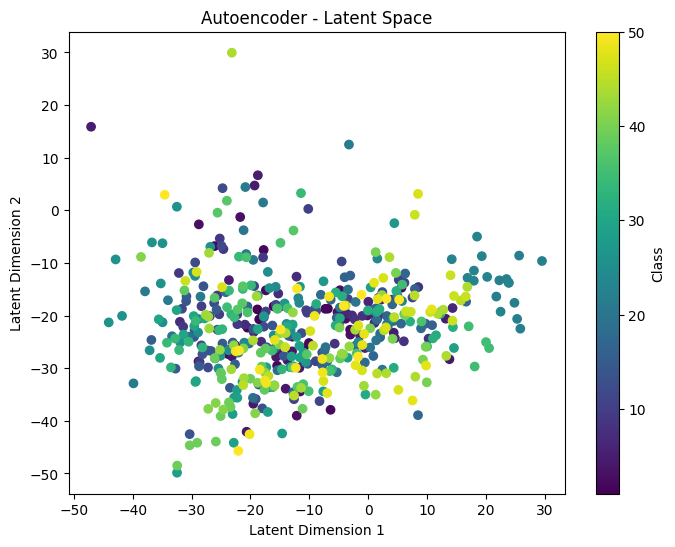

In [13]:
import matplotlib.pyplot as plt

# Plot the encoded (latent) representations
plt.figure(figsize=(8, 6))
plt.scatter(encoded_features_np[:, 0], encoded_features_np[:, 1], c=label_seen_np, cmap='viridis')
plt.title('Autoencoder - Latent Space')
plt.xlabel('Latent Dimension 1')
plt.ylabel('Latent Dimension 2')
plt.colorbar(label='Class')
plt.show()

# making of the model

In [90]:
import numpy as np
#Use 50 categories
index_seen = np.squeeze(np.where(label_seen < 51, True, False))
index_unseen = np.squeeze(np.where(label_unseen < 51, True, False))

#Use 20 categories
# index_seen = np.squeeze(np.where(label_seen < 21, True, False))
# index_unseen = np.squeeze(np.where(label_unseen < 21, True, False))

brain_seen = brain_seen[index_seen, :]
image_seen = image_seen[index_seen, :]
text_seen = text_seen[index_seen, :]
label_seen = label_seen[index_seen]
brain_unseen = brain_unseen[index_unseen, :]
image_unseen = image_unseen[index_unseen, :]
text_unseen = text_unseen[index_unseen, :]
label_unseen = label_unseen[index_unseen]

#The ThingsEEG-Text dataset is mainly designed and used for Zero-Shot type research work, because the independence of its training set and test set
#in categories is very suitable for this task. If it needs to be used for other types of tasks
#(such as general classification or cross-modal learning),
#the data may need to be repartitioned. Therefore, we repartition the dataset to make it better for our task
#Define the number of classes and the number of samples per class
num_classes = 20
samples_per_class = 10
#For each class, take the first 5 images as training and the last 5 images as testing
new_train_brain = []
new_train_image = []
new_train_text = []
new_train_label = []

new_test_brain = []
new_test_image = []
new_test_text = []
new_test_label = []

for i in range(num_classes):
    start_idx = i * samples_per_class#The starting index of the current class
    end_idx = start_idx + samples_per_class#The end index of the current class
    #Get the data of the current class
    class_data_brain = brain_seen[start_idx:end_idx, :]
    #Divided into training set and test set
    new_train_brain.append(class_data_brain[:7])
    new_test_brain.append(class_data_brain[7:])

    class_data_image = image_seen[start_idx:end_idx, :]

    new_train_image.append(class_data_image[:7])
    new_test_image.append(class_data_image[7:])

    class_data_text = text_seen[start_idx:end_idx, :]

    new_train_text.append(class_data_text[:7])
    new_test_text.append(class_data_text[7:])

    class_data_label = label_seen[start_idx:end_idx, :]

    new_train_label.append(class_data_label[:7])
    new_test_label.append(class_data_label[7:])

train_brain = torch.vstack(new_train_brain)
train_image = torch.vstack(new_train_image)
train_text = torch.vstack(new_train_text)
train_label = torch.vstack(new_train_label)
test_brain = torch.vstack(new_test_brain)
test_image = torch.vstack(new_test_image)
test_text = torch.vstack(new_test_text)
test_label = torch.vstack(new_test_label)

print(train_brain.shape)
print(train_image.shape)
print(train_text.shape)
print(train_label.shape)
print(test_brain.shape)
print(test_image.shape)
print(test_text.shape)
print(test_label.shape)

torch.Size([140, 561])
torch.Size([140, 100])
torch.Size([140, 512])
torch.Size([140, 1])
torch.Size([60, 561])
torch.Size([60, 100])
torch.Size([60, 512])
torch.Size([60, 1])


In [91]:
import torch
import numpy as np
from sklearn import svm
from sklearn.metrics import accuracy_score, classification_report

train_brain_np = train_brain.numpy()
train_image_np = train_image.numpy()
train_text_np = train_text.numpy()
train_label_np = train_label.numpy().ravel()

test_brain_np = test_brain.numpy()
test_image_np = test_image.numpy()
test_text_np = test_text.numpy()
test_label_np = test_label.numpy().ravel()


train_features = train_brain_np #we only use brain feature
test_features = test_brain_np

In [14]:
# combining features

In [92]:
train_features_combined = np.hstack((train_brain_np, train_image_np, train_text_np))
test_features_combined = np.hstack((test_brain_np, test_image_np, test_text_np))

In [93]:
# Train an SVM with RBF kernel
svm_model = svm.SVC(kernel='rbf', C=1.0, gamma='scale')
svm_model.fit(train_features_combined, train_label_np)


SVC()

In [94]:
# Predict on the test set
test_predictions = svm_model.predict(test_features_combined)

# Evaluate the model
accuracy = accuracy_score(test_label_np, test_predictions)
report = classification_report(test_label_np, test_predictions)

print(f'Accuracy: {accuracy:.2f}')
print('Classification Report:')
print(report)

Accuracy: 0.83
Classification Report:
              precision    recall  f1-score   support

           1       0.75      1.00      0.86         3
           2       0.50      0.67      0.57         3
           3       1.00      1.00      1.00         3
           4       0.60      1.00      0.75         3
           5       0.60      1.00      0.75         3
           6       1.00      0.67      0.80         3
           7       1.00      0.67      0.80         3
           8       1.00      1.00      1.00         3
           9       1.00      0.67      0.80         3
          10       1.00      1.00      1.00         3
          11       0.50      0.33      0.40         3
          12       1.00      1.00      1.00         3
          13       0.75      1.00      0.86         3
          14       1.00      1.00      1.00         3
          15       1.00      1.00      1.00         3
          16       1.00      1.00      1.00         3
          17       0.50      0.33      0.40

model with out scikit learn 

In [95]:
import numpy as np

# RBF Kernel
def rbf_kernel(x1, x2, gamma=0.1):
    diff = x1 - x2
    return np.exp(-gamma * np.dot(diff, diff))

# Compute Gram Matrix
def compute_gram_matrix(X, gamma=0.1):
    n_samples = X.shape[0]
    K = np.zeros((n_samples, n_samples))
    for i in range(n_samples):
        for j in range(n_samples):
            K[i, j] = rbf_kernel(X[i], X[j], gamma)
    return K

# Train SVM using dual formulation
def train_svm_rbf_manual(X, y, C=1.0, gamma=0.1, max_iter=1000, learning_rate=0.001, tolerance=1e-6):
    n_samples, n_features = X.shape
    alphas = np.zeros(n_samples)  # Lagrange multipliers
    b = 0.0
    
    # Compute Gram matrix
    K = compute_gram_matrix(X, gamma)

    for iteration in range(max_iter):
        alpha_prev = np.copy(alphas)

        for i in range(n_samples):
            # Decision boundary for i-th sample
            decision = np.sum(alphas * y * K[:, i]) + b
            
            # Gradient ascent update for alpha_i
            alphas[i] += learning_rate * (1 - y[i] * decision)

            # Clip alpha to stay within bounds [0, C]
            alphas[i] = np.clip(alphas[i], 0, C)

        # Check for convergence
        if np.linalg.norm(alphas - alpha_prev) < tolerance:
            print(f"Converged after {iteration} iterations")
            break

    # Find support vectors
    support_vector_indices = alphas > tolerance
    alphas = alphas[support_vector_indices]
    support_vectors = X[support_vector_indices]
    support_vector_labels = y[support_vector_indices]

    # Calculate intercept
    b = np.mean(
        support_vector_labels - np.sum(alphas * support_vector_labels[:, None] * K[support_vector_indices][:, support_vector_indices], axis=1)
    )
    
    return alphas, support_vectors, support_vector_labels, b

# Prediction
def predict_svm_rbf(X, support_vectors, support_vector_labels, alphas, b, gamma=0.1):
    predictions = []
    for x in X:
        decision = np.sum(
            alphas * support_vector_labels * np.array([rbf_kernel(x, sv, gamma) for sv in support_vectors])
        ) + b
        predictions.append(np.sign(decision))
    return np.array(predictions)

# Combine features from brain, image, and text
train_features = np.hstack((train_brain_np, train_image_np, train_text_np))
test_features = np.hstack((test_brain_np, test_image_np, test_text_np))

# Normalize features
train_features = (train_features - train_features.mean(axis=0)) / train_features.std(axis=0)
test_features = (test_features - train_features.mean(axis=0)) / train_features.std(axis=0)

# Train SVM
alphas, support_vectors, support_vector_labels, intercept = train_svm_rbf_manual(
    train_features, train_label_np, C=1.0, gamma=0.1
)

# Predict on test set
predictions = predict_svm_rbf(test_features, support_vectors, support_vector_labels, alphas, intercept, gamma=0.1)

# Evaluate
accuracy = np.mean(predictions == test_label_np)
print("Test Accuracy:", accuracy)

Test Accuracy: 0.05


In [96]:
import numpy as np

# Sigmoid function
def sigmoid(z):
    return 1 / (1 + np.exp(-z))

# Cost function (Binary Cross-Entropy)
def compute_cost(X, y, weights, bias):
    n_samples = X.shape[0]
    linear_model = np.dot(X, weights) + bias
    predictions = sigmoid(linear_model)
    cost = -1 / n_samples * np.sum(y * np.log(predictions + 1e-9) + (1 - y) * np.log(1 - predictions + 1e-9))
    return cost

# Gradient Descent
def gradient_descent(X, y, weights, bias, learning_rate):
    n_samples = X.shape[0]
    linear_model = np.dot(X, weights) + bias
    predictions = sigmoid(linear_model)
    
    # Compute gradients
    dw = 1 / n_samples * np.dot(X.T, (predictions - y))
    db = 1 / n_samples * np.sum(predictions - y)
    
    # Update parameters
    weights -= learning_rate * dw
    bias -= learning_rate * db
    
    return weights, bias

# Logistic Regression Model
def train_logistic_regression(X, y, learning_rate=0.01, n_iters=1000):
    n_samples, n_features = X.shape
    weights = np.zeros(n_features)
    bias = 0
    
    for i in range(n_iters):
        weights, bias = gradient_descent(X, y, weights, bias, learning_rate)
        
        if i % 100 == 0:
            cost = compute_cost(X, y, weights, bias)
            print(f"Iteration {i}, Cost: {cost:.4f}")
    
    return weights, bias

# Prediction
def predict(X, weights, bias, threshold=0.5):
    linear_model = np.dot(X, weights) + bias
    probabilities = sigmoid(linear_model)
    return (probabilities >= threshold).astype(int)

# Combine features from brain, image, and text
train_features = np.hstack((train_brain_np, train_image_np, train_text_np))
test_features = np.hstack((test_brain_np, test_image_np, test_text_np))

# Normalize features
train_features = (train_features - train_features.mean(axis=0)) / train_features.std(axis=0)
test_features = (test_features - train_features.mean(axis=0)) / train_features.std(axis=0)

# Convert labels to binary (if applicable)
train_label_binary = (train_label_np == 1).astype(int)
test_label_binary = (test_label_np == 1).astype(int)

# Train Logistic Regression Model
weights, bias = train_logistic_regression(train_features, train_label_binary, learning_rate=0.01, n_iters=1000)

# Predict on Test Set
predictions = predict(test_features, weights, bias)

# Evaluate
accuracy = np.mean(predictions == test_label_binary)
print("Test Accuracy:", accuracy)

Iteration 0, Cost: 0.6829
Iteration 100, Cost: 0.4003
Iteration 200, Cost: 0.2833
Iteration 300, Cost: 0.2150
Iteration 400, Cost: 0.1713
Iteration 500, Cost: 0.1415
Iteration 600, Cost: 0.1200
Iteration 700, Cost: 0.1039
Iteration 800, Cost: 0.0915
Iteration 900, Cost: 0.0816
Test Accuracy: 0.7666666666666667


In [97]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report
import numpy as np

# Combine features from brain, image, and text
train_features = np.hstack((train_brain_np, train_image_np, train_text_np))
test_features = np.hstack((test_brain_np, test_image_np, test_text_np))

# Normalize features
train_features = (train_features - train_features.mean(axis=0)) / train_features.std(axis=0)
test_features = (test_features - train_features.mean(axis=0)) / train_features.std(axis=0)

# Train Random Forest Classifier
rf = RandomForestClassifier(
    n_estimators=100,          # Number of trees
    max_depth=10,              # Maximum depth of each tree
    max_features='sqrt',       # Number of features to consider at each split
    random_state=42            # For reproducibility
)
rf.fit(train_features, train_label_np)

# Predict on Test Set
predictions = rf.predict(test_features)

# Evaluate Model
accuracy = accuracy_score(test_label_np, predictions)
print("Test Accuracy:", accuracy)
print("\nClassification Report:\n", classification_report(test_label_np, predictions))

Test Accuracy: 0.7

Classification Report:
               precision    recall  f1-score   support

           1       0.50      1.00      0.67         3
           2       0.00      0.00      0.00         3
           3       0.00      0.00      0.00         3
           4       1.00      0.67      0.80         3
           5       1.00      1.00      1.00         3
           6       0.50      1.00      0.67         3
           7       1.00      0.67      0.80         3
           8       0.50      0.33      0.40         3
           9       1.00      0.67      0.80         3
          10       1.00      1.00      1.00         3
          11       0.27      1.00      0.43         3
          12       1.00      0.67      0.80         3
          13       0.75      1.00      0.86         3
          14       1.00      0.67      0.80         3
          15       1.00      0.67      0.80         3
          16       1.00      1.00      1.00         3
          17       1.00      1.00    

/Users/morgan/Library/Python/3.9/lib/python/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/morgan/Library/Python/3.9/lib/python/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/morgan/Library/Python/3.9/lib/python/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(resu

In [98]:
# Brain-only training
X_train_brain = train_brain_np  # shape: (N_train, 561)
y_train = train_label_np         # shape: (N_train,)
X_test_brain = test_brain_np     # shape: (N_test, 561)
y_test = test_label_np           # shape: (N_test,)

# Create and train the Random Forest
rf_brain = RandomForestClassifier(n_estimators=100, random_state=42)
rf_brain.fit(X_train_brain, y_train)

# Predict
y_pred_brain = rf_brain.predict(X_test_brain)

# Evaluate
acc_brain = accuracy_score(y_test, y_pred_brain)
print("Brain-Only Random Forest Accuracy: {:.3f}".format(acc_brain))
print("Classification Report (Brain-Only):\n", classification_report(y_test, y_pred_brain))

Brain-Only Random Forest Accuracy: 0.217
Classification Report (Brain-Only):
               precision    recall  f1-score   support

           1       1.00      0.33      0.50         3
           2       0.00      0.00      0.00         3
           3       0.00      0.00      0.00         3
           4       0.00      0.00      0.00         3
           5       0.20      0.33      0.25         3
           6       0.50      0.33      0.40         3
           7       0.00      0.00      0.00         3
           8       0.50      0.33      0.40         3
           9       0.00      0.00      0.00         3
          10       0.33      0.33      0.33         3
          11       0.00      0.00      0.00         3
          12       0.00      0.00      0.00         3
          13       0.67      0.67      0.67         3
          14       0.33      0.33      0.33         3
          15       0.50      0.67      0.57         3
          16       0.00      0.00      0.00         3
   

In [99]:
# Combine the features
X_train_all = np.hstack([train_brain_np, train_image_np, train_text_np])
X_test_all = np.hstack([test_brain_np, test_image_np, test_text_np])

print("Combined Training shape:", X_train_all.shape)
print("Combined Testing shape:", X_test_all.shape)

# Create and train the Random Forest
rf_all = RandomForestClassifier(n_estimators=100, random_state=42)
rf_all.fit(X_train_all, y_train)

# Predict
y_pred_all = rf_all.predict(X_test_all)

# Evaluate
acc_all = accuracy_score(y_test, y_pred_all)
print("All-Modalities Random Forest Accuracy: {:.3f}".format(acc_all))
print("Classification Report (All Modalities):\n", classification_report(y_test, y_pred_all))

Combined Training shape: (140, 1173)
Combined Testing shape: (60, 1173)
All-Modalities Random Forest Accuracy: 0.917
Classification Report (All Modalities):
               precision    recall  f1-score   support

           1       1.00      1.00      1.00         3
           2       1.00      0.33      0.50         3
           3       1.00      1.00      1.00         3
           4       1.00      0.67      0.80         3
           5       1.00      1.00      1.00         3
           6       1.00      1.00      1.00         3
           7       0.75      1.00      0.86         3
           8       0.75      1.00      0.86         3
           9       1.00      1.00      1.00         3
          10       1.00      1.00      1.00         3
          11       0.67      0.67      0.67         3
          12       1.00      1.00      1.00         3
          13       0.75      1.00      0.86         3
          14       1.00      1.00      1.00         3
          15       1.00      1.

# using all the data 

In [101]:
X_brain_np = brain_seen.numpy()  # (16540, 561)
X_image_np = image_seen.numpy()  # (16540, 100)
X_text_np  = text_seen.numpy()   # (16540, 512)
y_np       = label_seen.numpy().ravel()  # (16540,)

# Combine all features, if desired:
X_all_np = np.hstack([X_brain_np, X_image_np, X_text_np])
print("X_all_np shape:", X_all_np.shape)  # (16540, 1173)

X_all_np shape: (500, 1173)


In [102]:
X_train_all, X_test_all, y_train, y_test = train_test_split(
    X_all_np,
    y_np,
    test_size=0.2,
    stratify=y_np,
    random_state=42
)

print("Train Combined:", X_train_all.shape, "Test Combined:", X_test_all.shape)

Train Combined: (400, 1173) Test Combined: (100, 1173)


# evaluation


In [ ]:
from sklearn.metrics import classification_report

print(classification_report(y_true, y_pred))

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, cmap="Blues")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.show()

zero shot learning pardigm?

In [ ]:
# diffrent pardigm 

In [ ]:
split_ratios = [0.6, 0.7, 0.8]  # You can add more if you like

for train_ratio in split_ratios:
    test_ratio = 1.0 - train_ratio

    X_train, X_test, y_train, y_test = train_test_split(
        X_seen,
        y_seen,
        test_size=test_ratio,
        stratify=y_seen,       # keep class distribution consistent
        random_state=42
    )

    # Train a Random Forest
    rf = RandomForestClassifier(n_estimators=100, random_state=42)
    rf.fit(X_train, y_train)

    # Predict on test set
    y_pred = rf.predict(X_test)

    # Evaluate
    acc = accuracy_score(y_test, y_pred)
    print(f"\n=== Split: {int(train_ratio*100)}% Train / {int(test_ratio*100)}% Test ===")
    print("Train size:", X_train.shape[0], "  Test size:", X_test.shape[0])
    print("Accuracy:", acc)
    print("Classification Report:\n", classification_report(y_test, y_pred))

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim

# 1) Suppose we have:
#    - brain_seen: shape (N_seen, 561)
#    - label_seen: shape (N_seen,) with integer classes for seen only
#    - text_embeds: shape (TotalClasses, embedding_dim), e.g. (185, 512)
#      (This includes vectors for both seen & unseen classes, but we only
#       train using the "seen" portion.)

# 2) Build a mapping net from EEG -> text embedding
class EEGToTextModel(nn.Module):
    def __init__(self, input_dim=561, embed_dim=512, hidden_dim=256):
        super().__init__()
        self.fc1 = nn.Linear(input_dim, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, embed_dim)
    
    def forward(self, x):
        x = torch.relu(self.fc1(x))
        x = self.fc2(x)
        return x

model = EEGToTextModel(input_dim=561, embed_dim=512)

# 3) Training Data: For each EEG sample x, the "target" is the text embed of its class
#    We'll gather them in a dataset.

seen_labels = label_seen.squeeze()  # shape: (N_seen,)
# text_embeds[c] is the embedding for class c
y_text = []
for c in seen_labels:
    c = int(c)  # ensure it's int
    # c should be in the range of "seen classes" indexes
    y_text.append(text_embeds[c])  # shape (512,)

y_text = torch.stack(y_text)  # (N_seen, 512)

X_brain = brain_seen  # shape (N_seen, 561), assuming torch Tensor
# e.g. create a standard PyTorch dataset:
train_dataset = torch.utils.data.TensorDataset(X_brain, y_text)
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=32, shuffle=True)

# 4) Train loop
criterion = nn.MSELoss()  # or L1Loss, or a cosine embedding loss
optimizer = optim.Adam(model.parameters(), lr=1e-3)

num_epochs = 5
model.train()
for epoch in range(num_epochs):
    for batch_x, batch_y in train_loader:
        optimizer.zero_grad()
        pred_y = model(batch_x)  # shape (batch, embed_dim)
        loss = criterion(pred_y, batch_y) 
        loss.backward()
        optimizer.step()
    print(f"Epoch {epoch+1}, Loss: {loss.item()}")

# 5) Zero-Shot Inference: For an unseen EEG sample x_unseen, get predicted embed
#    Then compute similarity to each unseen class embedding
model.eval()

def predict_unseen_label(x_unseen):
    with torch.no_grad():
        x_embed = model(x_unseen.unsqueeze(0))  # shape: (1, embed_dim)
    # Suppose unseen_class_idxs = [some list of class IDs for the unseen set]
    cos = nn.CosineSimilarity(dim=1)
    best_class = None
    best_score = -1
    for c in unseen_class_idxs:
        embed_c = text_embeds[c].unsqueeze(0)  # shape: (1, embed_dim)
        score = cos(x_embed, embed_c)          # scalar
        if score > best_score:
            best_score = score
            best_class = c
    return best_class

# Evaluate how many times we get the correct unseen label, etc.

In [ ]:
# use validation set to evaluate the model